<a href="https://colab.research.google.com/github/MostafaNabieh/Brain-tumor-prediction-project/blob/master/Brain_Tumor_MRI_Classification_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**<center><font size=5>Brain Tumor Detection with Transefer Learning </font></center>**

**Table of Contents**
- <a href='#intro'>1. Project Overview and Objectives</a> 
    - <a href='#dataset'>1.1. Data Set Description</a>
    - <a href='#tumor'>1.2. What is Brain Tumor?</a>
- <a href='#env'>2. Setting up the Environment</a>
- <a href='#import'>3. Data Import and Preprocessing</a>
- <a href='#cnn'>4. CNN Model</a>
    - <a href='#aug'>4.1. Data Augmentation</a>
        - <a href='#demo'>4.1.1. Demo</a>
        - <a href='#apply'>4.1.2. Apply</a>
    - <a href='#build'>4.2. Transfer Learning Tutorial </a>
    - <a href='#perf'>4.3. Model Performance</a>
- <a href='#concl'>5. Conclusions</a>

# <a id='intro'>1. Project Overview and Objectives</a>

The main purpose of this project was to build a CNN model that would classify if subject has a tumor or not base on MRI scan. I used the VGG-16, Inception v3 , xception model architecture and weights to train the model for this binary problem. I used `accuracy` as a metric to justify the model performance which can be defined as:

$\textrm{Accuracy} = \frac{\textrm{Number of correclty predicted images}}{\textrm{Total number of tested images}} \times 100\%$

Final results look as follows:

| Set | Accuracy |
|:-:|:-:|
| Validation Set* | ~92% |
| Test Set* | ~92% |
<br>
\* *Note: there might be some misunderstanding in terms of set names so I want to describe what do I mean by `test` and `validation` set:*
* *`validation set` - is the set used during the model training to adjust the hyperparameters. *
* *`test set` - is the small set that I don't touch for the whole training process at all. It's been used for final model performance evaluation.*

## <a id='dataset'>1.1. Data Set Description</a>

The image data that was used for this problem is [Brain MRI Images for Brain Tumor Detection](https://www.kaggle.com/navoneel/brain-mri-images-for-brain-tumor-detection). It conists of MRI scans of two classes:

* `NO` - no tumor, encoded as `0`
* `YES` - tumor, encoded as `1`

Unfortunately, the data set description doesn't hold any information where this MRI scans come from and so on.

## <a id='tumor'>1.2. What is Brain Tumor?</a>

> A brain tumor occurs when abnormal cells form within the brain. There are two main types of tumors: cancerous (malignant) tumors and benign tumors. Cancerous tumors can be divided into primary tumors, which start within the brain, and secondary tumors, which have spread from elsewhere, known as brain metastasis tumors. All types of brain tumors may produce symptoms that vary depending on the part of the brain involved. These symptoms may include headaches, seizures, problems with vision, vomiting and mental changes. The headache is classically worse in the morning and goes away with vomiting. Other symptoms may include difficulty walking, speaking or with sensations. As the disease progresses, unconsciousness may occur.
>
> ![](https://upload.wikimedia.org/wikipedia/commons/5/5f/Hirnmetastase_MRT-T1_KM.jpg)
>
> *Brain metastasis in the right cerebral hemisphere from lung cancer, shown on magnetic resonance imaging.*

Source: [Wikipedia](https://en.wikipedia.org/wiki/Brain_tumor)

# <a id='env'>2. Setting up the Environment</a>

In [ ]:
from IPython.display import clear_output
!pip install imutils
clear_output()

from keras.applications.vgg19 import VGG19,preprocess_input
from keras.applications.xception import Xception,preprocess_input
from keras.applications.inception_v3 import InceptionV3,inception_v3
from keras.applications.resnet50 import ResNet50,resnet50
from keras.applications.resnet import ResNet101,ResNet152
from keras.applications.resnet_v2 import ResNet50V2,ResNet101V2,ResNet152V2
from keras.applications.vgg19 import VGG19
from keras.applications.inception_resnet_v2 import InceptionResNetV2
from keras.applications.mobilenet import MobileNet 
from keras.applications.mobilenet_v2 import MobileNetV2
from keras.applications.nasnet import NASNetMobile
from keras.applications.densenet import DenseNet121
import warnings
warnings.filterwarnings("ignore")


Using TensorFlow backend.


In [ ]:
import numpy as np 
from tqdm import tqdm
import cv2
import os
import shutil
import itertools
import imutils
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
# plotly
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly import tools
# keras
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import VGG16, preprocess_input
from keras import layers
from keras.models import Model, Sequential
from keras.optimizers import Adam, RMSprop
from keras.callbacks import EarlyStopping

init_notebook_mode(connected=True)
RANDOM_SEED = 123

Right now all images are in one folder with `yes` and `no` subfolders. I will split the data into `train`, `val` and `test` folders which makes its easier to work for me. The new folder heirarchy will look as follows:

In [ ]:
!apt-get install tree
#clear_output()
# create new folders
!mkdir TRAIN TEST VAL TRAIN/YES TRAIN/NO TEST/YES TEST/NO VAL/YES VAL/NO
!tree -d

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 25 not upgraded.
Need to get 40.7 kB of archives.
After this operation, 105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tree amd64 1.7.0-5 [40.7 kB]
Fetched 40.7 kB in 0s (729 kB/s)
Selecting previously unselected package tree.
(Reading database ... 145113 files and directories currently installed.)
Preparing to unpack .../tree_1.7.0-5_amd64.deb ...
Unpacking tree (1.7.0-5) ...
Setting up tree (1.7.0-5) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...
.
├── sample_data
├── TEST
│   ├── NO
│   └── YES
├── TRAIN
│   ├── NO
│   └── YES
└── VAL
    ├── NO
    └── YES

10 directories


In [ ]:
from google.colab import drive
drive.mount('/gdrive')

In [ ]:
import zipfile  # For faster extraction
dataset_path = "/gdrive/My Drive/brain-mri-images-for-brain-tumor-detection.zip"  # Replace with your dataset path
zfile = zipfile.ZipFile(dataset_path)
zfile.extractall()

In [ ]:
IMG_PATH = 'brain-mri-images-for-brain-tumor-detection/brain_tumor_dataset/'

In [ ]:
# split the data by train/val/test
for CLASS in os.listdir(IMG_PATH):
    if not CLASS.startswith('.'):
        IMG_NUM = len(os.listdir(IMG_PATH + CLASS))
        for (n, FILE_NAME) in enumerate(os.listdir(IMG_PATH + CLASS)):
            img = IMG_PATH + CLASS + '/' + FILE_NAME
            if n < 5:
                shutil.copy(img, 'TEST/' + CLASS.upper() + '/' + FILE_NAME)
            elif n < 0.8*IMG_NUM:
                shutil.copy(img, 'TRAIN/'+ CLASS.upper() + '/' + FILE_NAME)
            else:
                shutil.copy(img, 'VAL/'+ CLASS.upper() + '/' + FILE_NAME)

# <a id='import'>3. Data Import and Preprocessing</a>

In [ ]:
def load_data(dir_path, img_size=(100,100)):
    """
    Load resized images as np.arrays to workspace
    """
    X = []
    y = []
    i = 0
    labels = dict()
    for path in tqdm(sorted(os.listdir(dir_path))):
        if not path.startswith('.'):
            labels[i] = path
            for file in os.listdir(dir_path + path):
                if not file.startswith('.'):
                    img = cv2.imread(dir_path + path + '/' + file)
                    X.append(img)
                    y.append(i)
            i += 1
    X = np.array(X)
    y = np.array(y)
    print()
    print(f'{len(X)} images loaded from {dir_path} directory.')
    return X, y, labels



def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize = (6,6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    cm = np.round(cm,2)
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [ ]:
TRAIN_DIR = 'TRAIN/'
TEST_DIR = 'TEST/'
VAL_DIR = 'VAL/'
IMG_SIZE = (224,224)

# use predefined function to load the image data into workspace
X_train, y_train, labels = load_data(TRAIN_DIR, IMG_SIZE)
X_test, y_test, _ = load_data(TEST_DIR, IMG_SIZE)
X_val, y_val, _ = load_data(VAL_DIR, IMG_SIZE)

100%|██████████| 2/2 [00:00<00:00, 19.85it/s]


193 images loaded from TRAIN/ directory.

10 images loaded from TEST/ directory.

50 images loaded from VAL/ directory.


Let's take a look at the distribution of classes among sets:

# Enable plotly

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import IPython
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
configure_plotly_browser_state()


In [ ]:
y = dict()
y[0] = []
y[1] = []
for set_name in (y_train, y_val, y_test):
    y[0].append(np.sum(set_name == 0))
    y[1].append(np.sum(set_name == 1))

trace0 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[0],
    name='No',
    marker=dict(color='#33cc33'),
    opacity=0.7
)
trace1 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[1],
    name='Yes',
    marker=dict(color='#ff3300'),
    opacity=0.7
)
data = [trace0, trace1]
layout = go.Layout(
    title='Count of classes in each set',
    xaxis={'title': 'Set'},
    yaxis={'title': 'Count'}
)
fig = go.Figure(data, layout)
IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

iplot(fig)

In [ ]:
def plot_samples(X, y, labels_dict, n=50):
    """
    Creates a gridplot for desired number of images (n) from the specified set
    """
    for index in range(len(labels_dict)):
        imgs = (X[np.argwhere(y == index)][:n])/255
        j = 10
        i = int(n/j)

        plt.figure(figsize=(15,6))
        c = 1
        for img in imgs:
            plt.subplot(i,j,c)
            plt.imshow(img[0])

            plt.xticks([])
            plt.yticks([])
            c += 1
        plt.suptitle('Tumor: {}'.format(labels_dict[index]))
        plt.show()

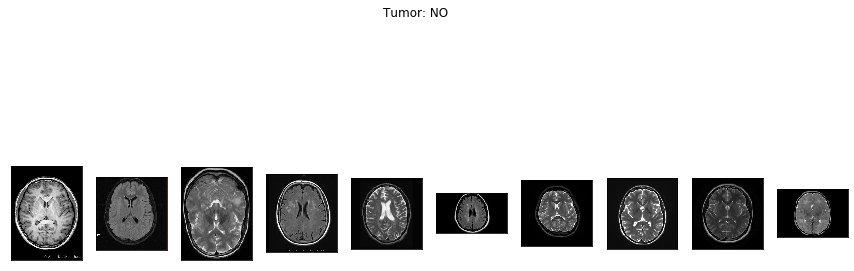

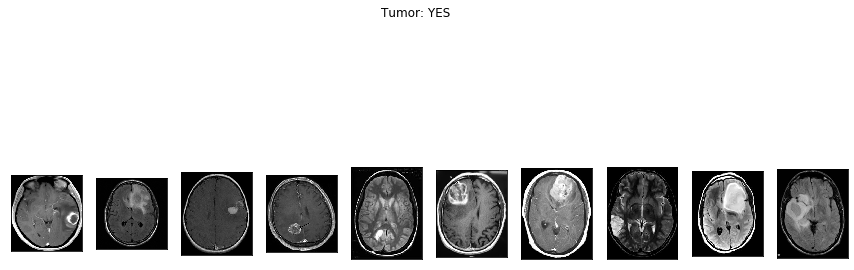

In [ ]:
plot_samples(X_train, y_train, labels, 10)

As you can see, images have different `width` and `height` and diffent size of "black corners". Since the image size for VGG-16 imput layer is `(224,224)` some wide images may look weird after resizing. Histogram of ratio distributions (`ratio = width/height`):

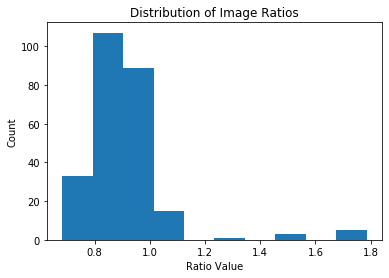

In [ ]:
RATIO_LIST = []
for set in (X_train, X_test, X_val):
    for img in set:
        RATIO_LIST.append(img.shape[1]/img.shape[0])
        
plt.hist(RATIO_LIST)
plt.title('Distribution of Image Ratios')
plt.xlabel('Ratio Value')
plt.ylabel('Count')
plt.show()

The first step of "normalization" would be to crop the brain out of the images. I used technique which was perfectly described in [pyimagesearch](https://www.pyimagesearch.com/2016/04/11/finding-extreme-points-in-contours-with-opencv/) blog and I highly suggest to looks deeper into it.

In [ ]:
def crop_imgs(set_name, add_pixels_value=0):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    set_new = []
    for img in set_name:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        gray = cv2.GaussianBlur(gray, (5, 5), 0)

        # threshold the image, then perform a series of erosions +
        # dilations to remove any small regions of noise
        thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
        thresh = cv2.erode(thresh, None, iterations=2)
        thresh = cv2.dilate(thresh, None, iterations=2)

        # find contours in thresholded image, then grab the largest one
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)

        # find the extreme points
        extLeft = tuple(c[c[:, :, 0].argmin()][0])
        extRight = tuple(c[c[:, :, 0].argmax()][0])
        extTop = tuple(c[c[:, :, 1].argmin()][0])
        extBot = tuple(c[c[:, :, 1].argmax()][0])

        ADD_PIXELS = add_pixels_value
        new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()
        set_new.append(new_img)

    return np.array(set_new)

Let's look at example what this function will do with MRI scans:

In [ ]:
img = cv2.imread('brain-mri-images-for-brain-tumor-detection/brain_tumor_dataset/yes/Y108.jpg')
img = cv2.resize(
            img,
            dsize=IMG_SIZE,
            interpolation=cv2.INTER_CUBIC
        )
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray = cv2.GaussianBlur(gray, (5, 5), 0)

# threshold the image, then perform a series of erosions +
# dilations to remove any small regions of noise
thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.erode(thresh, None, iterations=2)
thresh = cv2.dilate(thresh, None, iterations=2)

# find contours in thresholded image, then grab the largest one
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
c = max(cnts, key=cv2.contourArea)

# find the extreme points
extLeft = tuple(c[c[:, :, 0].argmin()][0])
extRight = tuple(c[c[:, :, 0].argmax()][0])
extTop = tuple(c[c[:, :, 1].argmin()][0])
extBot = tuple(c[c[:, :, 1].argmax()][0])

# add contour on the image
img_cnt = cv2.drawContours(img.copy(), [c], -1, (0, 255, 255), 4)

# add extreme points
img_pnt = cv2.circle(img_cnt.copy(), extLeft, 8, (0, 0, 255), -1)
img_pnt = cv2.circle(img_pnt, extRight, 8, (0, 255, 0), -1)
img_pnt = cv2.circle(img_pnt, extTop, 8, (255, 0, 0), -1)
img_pnt = cv2.circle(img_pnt, extBot, 8, (255, 255, 0), -1)

# crop
ADD_PIXELS = 0
new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

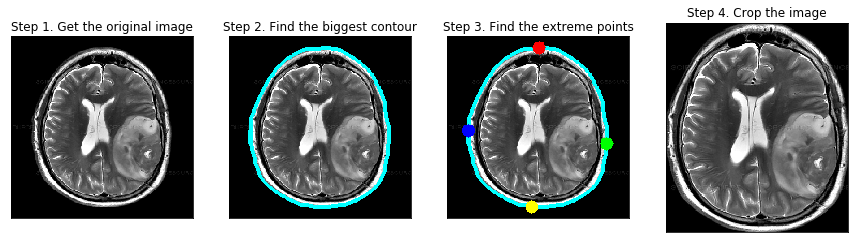

In [ ]:
plt.figure(figsize=(15,6))
plt.subplot(141)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Step 1. Get the original image')
plt.subplot(142)
plt.imshow(img_cnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 2. Find the biggest contour')
plt.subplot(143)
plt.imshow(img_pnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 3. Find the extreme points')
plt.subplot(144)
plt.imshow(new_img)
plt.xticks([])
plt.yticks([])
plt.title('Step 4. Crop the image')
plt.show()

In [ ]:
# apply this for each set
X_train_crop = crop_imgs(set_name=X_train)
X_val_crop = crop_imgs(set_name=X_val)
X_test_crop = crop_imgs(set_name=X_test)

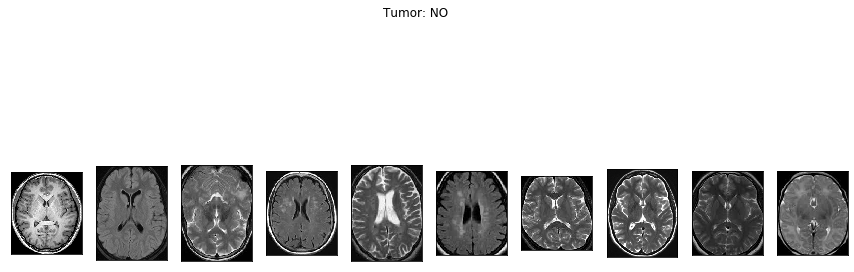

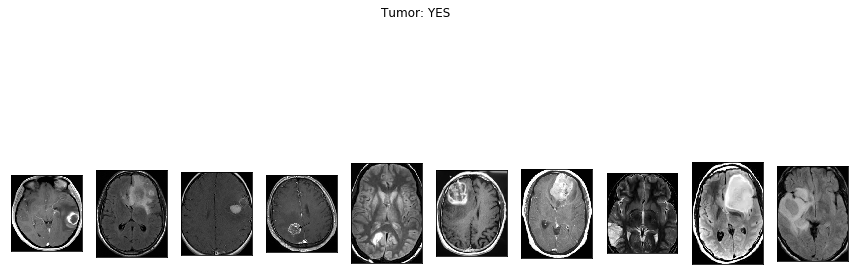

In [ ]:
plot_samples(X_train_crop, y_train, labels, 10)

In [ ]:
def save_new_images(x_set, y_set, folder_name):
    i = 0
    for (img, imclass) in zip(x_set, y_set):
        if imclass == 0:
            cv2.imwrite(folder_name+'NO/'+str(i)+'.jpg', img)
        else:
            cv2.imwrite(folder_name+'YES/'+str(i)+'.jpg', img)
        i += 1

In [ ]:
# saving new images to the folder
!mkdir TRAIN_CROP TEST_CROP VAL_CROP TRAIN_CROP/YES TRAIN_CROP/NO TEST_CROP/YES TEST_CROP/NO VAL_CROP/YES VAL_CROP/NO

save_new_images(X_train_crop, y_train, folder_name='TRAIN_CROP/')
save_new_images(X_val_crop, y_val, folder_name='VAL_CROP/')
save_new_images(X_test_crop, y_test, folder_name='TEST_CROP/')

The next step would be resizing images to `(224,224)` and applying preprocessing needed for VGG-16 model input.

In [ ]:
def preprocess_imgs(set_name, img_size):
    """
    Resize and apply VGG-15 preprocessing
    """
    set_new = []
    for img in set_name:
        img = cv2.resize(
            img,
            dsize=img_size,
            interpolation=cv2.INTER_CUBIC
        )
        set_new.append(preprocess_input(img))
    return np.array(set_new)

In [ ]:
X_train_prep = preprocess_imgs(set_name=X_train_crop, img_size=IMG_SIZE)
X_test_prep = preprocess_imgs(set_name=X_test_crop, img_size=IMG_SIZE)
X_val_prep = preprocess_imgs(set_name=X_val_crop, img_size=IMG_SIZE)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

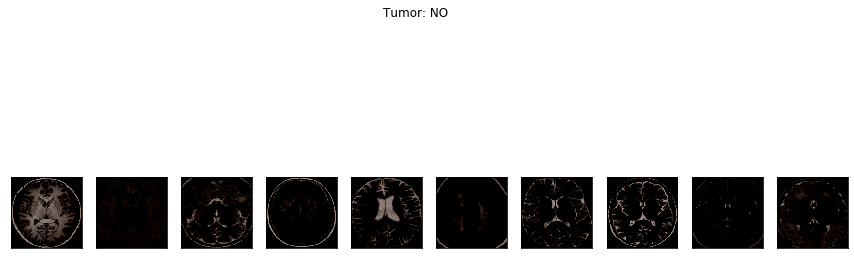

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

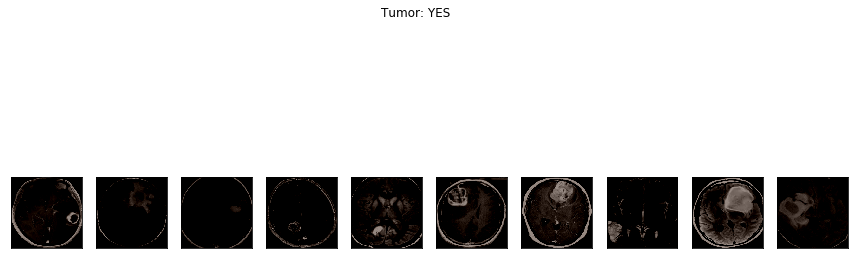

In [ ]:
 plot_samples(X_train_prep, y_train, labels, 10)

# <a id='cnn'>4. CNN Model</a>

I was using [Transfer Learning](https://towardsdatascience.com/keras-transfer-learning-for-beginners-6c9b8b7143e) with VGG-16 architecture , xception,InceptionV3 and weights as a base model.

## <a id='aug'>4.1. Data Augmentation</a>

Since I had small data set I used the technique called [Data Augmentation](https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html) which helps to "increase" the size of training set.

### <a id='demo'>4.1.1. Demo</a>

That's the example from one image how does augmentation look like.

In [ ]:
# set the paramters we want to change randomly
demo_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.05,
    height_shift_range=0.05,
    rescale=1./255,
    shear_range=0.05,
    brightness_range=[0.1, 1.5],
    horizontal_flip=True,
    vertical_flip=True
)

In [ ]:
os.mkdir('preview')
x = X_train_crop[0]  
x = x.reshape((1,) + x.shape) 

i = 0
for batch in demo_datagen.flow(x, batch_size=1, save_to_dir='preview', save_prefix='aug_img', save_format='jpg'):
    i += 1
    if i > 20:
        break 

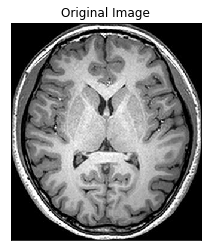

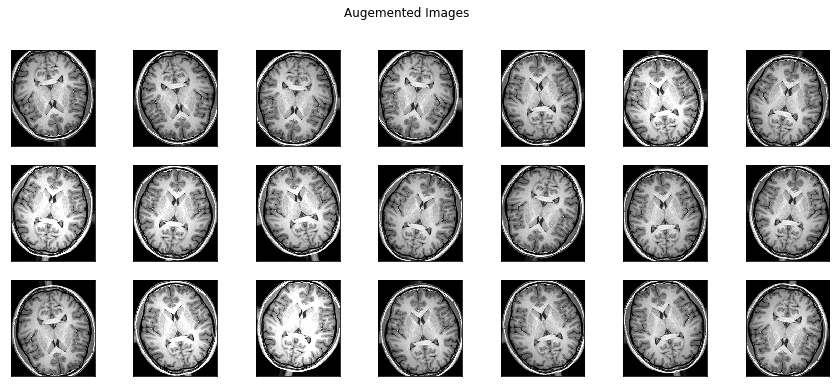

In [ ]:
plt.imshow(X_train_crop[0])
plt.xticks([])
plt.yticks([])
plt.title('Original Image')
plt.show()

plt.figure(figsize=(15,6))
i = 1
for img in os.listdir('preview/'):
    img = cv2.cv2.imread('preview/' + img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3,7,i)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    i += 1
    if i > 3*7:
        break
plt.suptitle('Augemented Images')
plt.show()

In [ ]:
!rm -rf preview/

### <a id='apply'>4.1.2. Apply</a>

In [ ]:
TRAIN_DIR = 'TRAIN_CROP/'
VAL_DIR = 'VAL_CROP/'

train_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    brightness_range=[0.5, 1.5],
    horizontal_flip=True,
    vertical_flip=True,
    preprocessing_function=preprocess_input
)

test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input
)


train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=32,
    class_mode='binary',
    seed=RANDOM_SEED
)


validation_generator = test_datagen.flow_from_directory(
    VAL_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=16,
    class_mode='binary',
    seed=RANDOM_SEED
)

Found 193 images belonging to 2 classes.
Found 50 images belonging to 2 classes.


## <a id='build'>4.2. Transfer Learning Tutorial</a>

# Transfer Learning Tutorial 

![Transfer Learning](https://cdn.elearningindustry.com/wp-content/uploads/2016/09/5-tips-improve-knowledge-transfer-elearning-e1475138920743.jpeg)

> In practice, very few people train an entire Convolutional Network from scratch (with random initialization), because it is relatively rare to have a dataset of sufficient size. Instead, it is common to pretrain a ConvNet on a very large dataset (e.g. ImageNet, which contains 1.2 million images with 1000 categories), and then use the ConvNet either as an initialization or a fixed feature extractor for the task of interest.

We always hear that we **do not have to reinvent the wheel**. Well, this is always true. Why do not we work and climb over the giant shoulders? Why do not we build something even if we change it a bit?
Well, that's not a theft. In fact, everything on the Internet without a license is open source. You can deal with a simple modification that you can get on your next research paper, but the purpose is to understand what has been completed and not just use it.


These two major Transfer learning scenarios look as follows:

**Finetuning the convnet**: Instead of random initializaion, we initialize the network with a pretrained network, like the one that is trained on imagenet 1000 dataset. Rest of the training looks as usual.

**ConvNet as fixed feature extractor**: Here, we will freeze the weights for all of the network except that of the final fully connected layer. This last fully connected layer is replaced with a new one with random weights and only this layer is trained.




I was wondering a few days ago if I had 1000 pictures of a dog in a folder , but I do not know the number of types of dogs inside. just 1000 pictures only, no more and no less with out topic or file name or folder name or just a small label . how can i apply classifer method on it ?
This was a big problem so I thought of some solutions that might be logical for most of us, namely, Transefer learning .
What if CNN was used and at the last activation Function was removed ?
The output must be Tensors *
Yes, a large array of matrices carry the standard Features of each dog and that is what I want.
Now I can use the compilation method and the elbow method to see how many dogs are in the picture
Then we apply one of the dimensions reduction algorithms Like (PCA) and use the k-nn algorithm, and then we will have half of the non-supervisory Deep learning algorithm called 
K-CNN.
I do not know What do you think ?



Well, it's a great idea but unfortunately there are people before me who wrote the paper but it does not matter I'll invent something else and I will write a research paper someday [Class Agnostic Image Common Object Detection](https://ieeexplore.ieee.org/document/8606132)


![Transefer Learning](https://cdn-images-1.medium.com/max/1600/1*9GTEzcO8KxxrfutmtsPs3Q.png)




In [ ]:
dataset_path = "/gdrive/My Drive/keras-pretrained-models.zip"  # Replace with your dataset path
zfile = zipfile.ZipFile(dataset_path)
zfile.extractall()

In [ ]:
# load base model
ResNet50_weight_path = 'resnet50_weights_tf_dim_ordering_tf_kernels_notop.h5'
resnet50_x = ResNet50(
    weights=ResNet50_weight_path,
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

In [ ]:
xception_weight_path='xception_weights_tf_dim_ordering_tf_kernels_notop.h5'
xception=Xception(
    weights=xception_weight_path,
    include_top=False, 
    input_shape=IMG_SIZE + (3,) 
)

In [ ]:
# load base model
InceptionV3_weight_path = 'inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'
inceptionV3 = InceptionV3(
     weights=InceptionV3_weight_path,
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

In [ ]:
# load base model
vgg16_weight_path = 'vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'
vgg = VGG16(
    weights=vgg16_weight_path,
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

In [ ]:
resnet101=ResNet101(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

171450368/171446536 [==============================] - 3s 0us/step


In [ ]:
resnet152=ResNet152(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

234700800/234698864 [==============================] - 4s 0us/step


In [ ]:
resnet50_v2=ResNet50V2(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

94674944/94668760 [==============================] - 1s 0us/step


In [ ]:
resnet101_v2=ResNet101V2(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

171319296/171317808 [==============================] - 2s 0us/step


In [ ]:
resnet152_v2=ResNet152V2(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

In [ ]:
inceptionResNetV2=InceptionResNetV2(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

219062272/219055592 [==============================] - 2s 0us/step


In [ ]:
# load base model
vgg19 = VGG19(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

80142336/80134624 [==============================] - 1s 0us/step


In [ ]:
denseNet121=DenseNet121(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

29089792/29084464 [==============================] - 0s 0us/step


In [ ]:
nASNetMobile=NASNetMobile(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

19996672/19993432 [==============================] - 0s 0us/step


In [ ]:
mobileNet=MobileNet(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

17227776/17225924 [==============================] - 0s 0us/step


In [ ]:
mobileNetV2=MobileNetV2(
    weights='imagenet',
    include_top=False, 
    input_shape=IMG_SIZE + (3,)
)

9412608/9406464 [==============================] - 0s 0us/step


In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
import cv2
import matplotlib.pyplot as plt
import os
import seaborn as sns
import umap
from PIL import Image
from scipy import misc
from os import listdir
from os.path import isfile, join
import numpy as np
from scipy import misc
from random import shuffle
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.utils.np_utils import to_categorical
from keras.layers import Input

In [ ]:
import os
import sys
import random
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from tqdm import tqdm
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

from keras.models import Model, load_model
from keras.layers import Input
from keras.layers.core import Dropout, Lambda
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
import keras


I also love the scholars to learn from them and their experiences, and to give me stories about them and their experiences in life.
I like their way of telling stories and giving me information, they sing for hours of hard and long work

This is exactly what happens in a model that has been trained on a lot of things. What we are doing now is to give out only two of the 1000 things that we know and ask. Do you know them?
Well, what would happen if we did not use weights for the model?
In that case it will be a normal model all you do is put it in your form and add the final layer **Flatten**  to initialize the model for the classification process

![](https://cdn-images-1.medium.com/max/1600/1*ZkPBqU8vx2vAgcLpz9pi5g.jpeg)

# VGG-16 

553467904/553467096 [==============================] - 5s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________


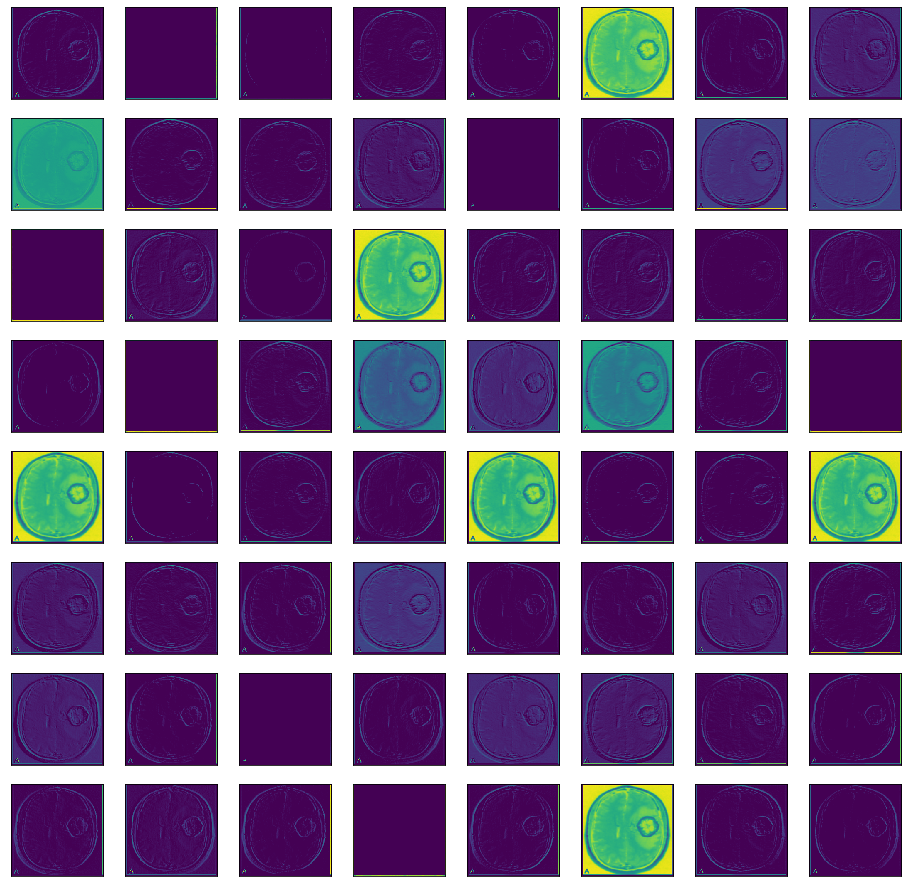

In [ ]:
# plot feature map of first conv layer for given image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot 
from numpy import expand_dims


f = plt.figure(figsize=(16,16))
# load the modelf = plt.figure(figsize=(10,3))
model = VGG16()
# redefine model to output right after the first hidden layer
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = pyplot.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='viridis')
		ix += 1
# show the figure
pyplot.show()


In [ ]:
NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
vgg16.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

vgg16.summary()

Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 512)         0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 25089     
Total params: 14,739,777
Trainable params

In [ ]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
import matplotlib.pyplot as plt
from numpy import expand_dims


# load the model
model = VGG16()
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		plt.figure(figsize=(64,64))
		for _ in range(square):
           

			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])
			
			# plot filter channel in grayscale
			plt.imshow(fmap[0, :, :, ix-1], cmap='viridis')
			ix += 1
	# show the figure
       
	plt.show()

In [ ]:
import time

start = time.time()

vgg16_history = vgg16.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)
end = time.time()
print(end - start)



Epoch 1/120
50/50 [==============================] - 31s 620ms/step - loss: 3.6394 - acc: 0.6730 - val_loss: 3.1614 - val_acc: 0.7382
Epoch 2/120
50/50 [==============================] - 23s 453ms/step - loss: 2.5453 - acc: 0.7429 - val_loss: 1.7855 - val_acc: 0.7853
Epoch 3/120
50/50 [==============================] - 23s 458ms/step - loss: 1.8329 - acc: 0.8295 - val_loss: 1.5308 - val_acc: 0.8586
Epoch 4/120
50/50 [==============================] - 23s 464ms/step - loss: 1.8042 - acc: 0.8079 - val_loss: 1.4543 - val_acc: 0.8995
Epoch 5/120
50/50 [==============================] - 23s 459ms/step - loss: 1.4404 - acc: 0.8595 - val_loss: 1.6017 - val_acc: 0.8377
Epoch 6/120
50/50 [==============================] - 23s 465ms/step - loss: 1.4756 - acc: 0.8322 - val_loss: 1.3628 - val_acc: 0.8016
Epoch 7/120
50/50 [==============================] - 24s 484ms/step - loss: 1.2239 - acc: 0.8809 - val_loss: 1.3575 - val_acc: 0.8613
Epoch 8/120
50/50 [==============================] - 23s 456

## Calculate Metric

In [ ]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = vgg16.evaluate(X_val_prep, y_val, verbose=0)
test_acc = vgg16.evaluate(X_test_prep, y_test, verbose=0)

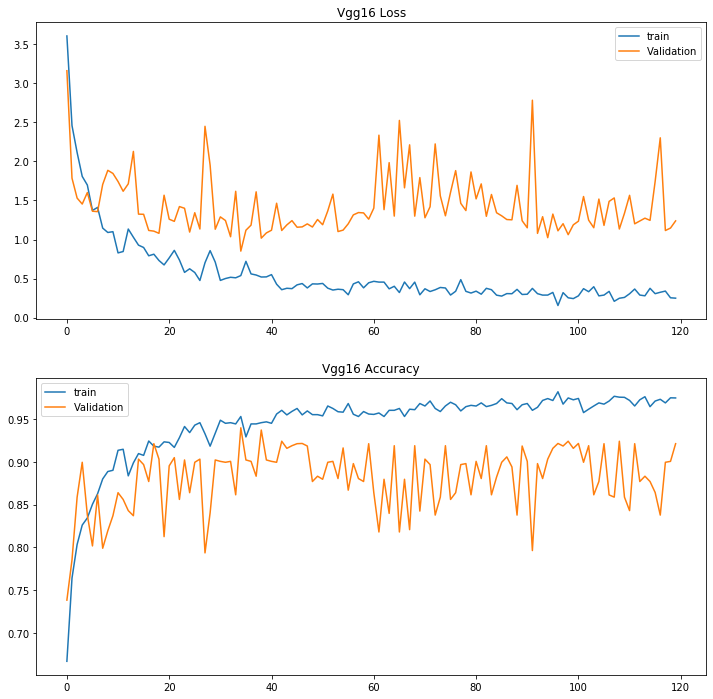

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['acc'], label='train')
pyplot.plot(vgg16_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

# save npy file for callback history

In [ ]:
np.save('2020-2-20-Dr-Abass-VGG_model.npy',vgg16_history)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.840, Test: 0.900


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.900000
Precision: 1.000000
Recall: 0.800000
F1 score: 0.888889


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.800000
ROC AUC: 0.900000
[[5 0]
 [1 4]]


# InceptionV3

In [ ]:
NUM_CLASSES = 1

inception_v3 = Sequential()
inception_v3.add(inceptionV3)
inception_v3.add(layers.Dropout(0.3))
inception_v3.add(layers.Flatten())
inception_v3.add(layers.Dropout(0.5))
inception_v3.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

inception_v3.layers[0].trainable = False

inception_v3.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)

inception_v3.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Model)         (None, 5, 5, 2048)        21802784  
_________________________________________________________________
dropout_9 (Dropout)          (None, 5, 5, 2048)        0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 51200)             0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 51200)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 51201     
Total params: 21,853,985
Trainable params: 51,201
Non-trainable params: 21,802,784
_________________________________________________________________


In [ ]:
import time

start = time.time()

inception_v3_history = inception_v3.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 38s 751ms/step - loss: 0.7588 - acc: 0.6312 - val_loss: 4.4819 - val_acc: 0.4843
Epoch 2/120
50/50 [==============================] - 22s 433ms/step - loss: 0.6415 - acc: 0.6697 - val_loss: 4.4033 - val_acc: 0.5842
Epoch 3/120
50/50 [==============================] - 22s 444ms/step - loss: 0.6516 - acc: 0.6929 - val_loss: 4.7810 - val_acc: 0.4974
Epoch 4/120
50/50 [==============================] - 22s 441ms/step - loss: 0.5563 - acc: 0.7458 - val_loss: 6.4121 - val_acc: 0.4212
Epoch 5/120
50/50 [==============================] - 22s 446ms/step - loss: 0.4838 - acc: 0.7945 - val_loss: 5.9896 - val_acc: 0.3979
Epoch 6/120
50/50 [==============================] - 23s 452ms/step - loss: 0.4821 - acc: 0.7771 - val_loss: 4.5443 - val_acc: 0.5272
Epoch 7/120
50/50 [==============================] - 23s 466ms/step - loss: 0.4358 - acc: 0.7927 - val_loss: 4.7356 - val_acc: 0.4921
Epoch 8/120
50/50 [==============================] - 22s 436ms

In [ ]:
# validate on val set
predictions = inception_v3.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = inception_v3.evaluate(X_val_prep, y_val, verbose=0)
test_acc = inception_v3.evaluate(X_test_prep, y_test, verbose=0)


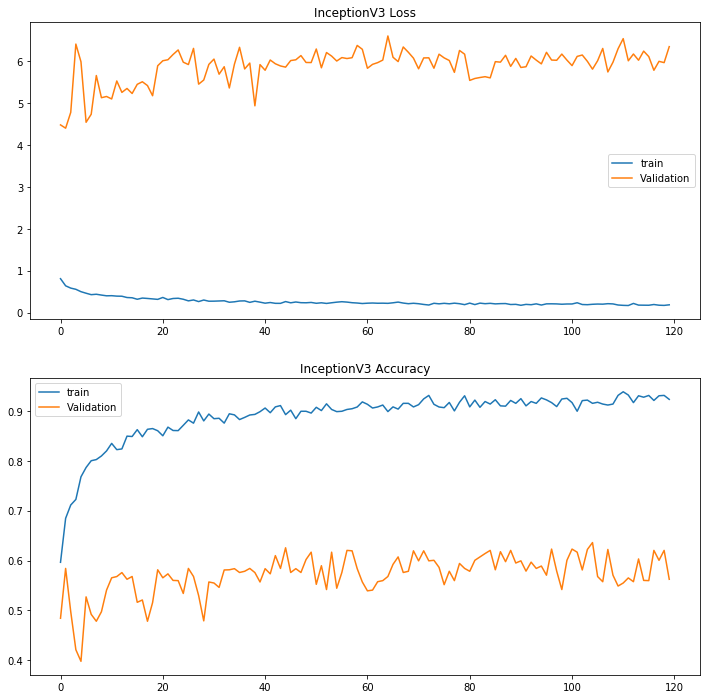

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('InceptionV3 Loss')
pyplot.plot(inception_v3_history.history['loss'], label='train')
pyplot.plot(inception_v3_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('InceptionV3 Accuracy')
pyplot.plot(inception_v3_history.history['acc'], label='train')
pyplot.plot(inception_v3_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
np.save('2020-2-20-Dr-Abass-InceptionV3_model.npy',inception_v3_history)
inception_v3.save('2020-2-20-Dr-Abass-InceptionV3_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.560, Test: 0.500


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 0.800000
F1 score: 0.615385


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[1 4]
 [1 4]]


# RESNET50

In [ ]:
NUM_CLASSES = 1

resnet50 = Sequential()
resnet50.add(resnet50_x)
resnet50.add(layers.Dropout(0.3))
resnet50.add(layers.Flatten())
resnet50.add(layers.Dropout(0.5))
resnet50.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet50.layers[0].trainable = False

resnet50.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet50.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet50.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 7, 7, 2048)        23587712  
_________________________________________________________________
dropout_11 (Dropout)         (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 100353    
Total params: 23,688,065
Trainable params: 100,353
Non-trainable params: 23,587,712
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet50_history = resnet50.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 35s 710ms/step - loss: 0.8681 - acc: 0.7532 - val_loss: 0.8623 - val_acc: 0.7356
Epoch 2/120
50/50 [==============================] - 22s 449ms/step - loss: 0.5288 - acc: 0.8506 - val_loss: 0.8061 - val_acc: 0.7853
Epoch 3/120
50/50 [==============================] - 23s 454ms/step - loss: 0.4157 - acc: 0.8882 - val_loss: 0.6819 - val_acc: 0.8586
Epoch 4/120
50/50 [==============================] - 23s 461ms/step - loss: 0.3262 - acc: 0.8974 - val_loss: 1.0549 - val_acc: 0.8179
Epoch 5/120
50/50 [==============================] - 23s 462ms/step - loss: 0.4073 - acc: 0.8980 - val_loss: 1.0915 - val_acc: 0.7958
Epoch 6/120
50/50 [==============================] - 23s 465ms/step - loss: 0.3144 - acc: 0.9050 - val_loss: 1.1076 - val_acc: 0.8424
Epoch 7/120
50/50 [==============================] - 24s 479ms/step - loss: 0.2980 - acc: 0.9283 - val_loss: 0.7083 - val_acc: 0.8613
Epoch 8/120
50/50 [==============================] - 23s 460ms

In [ ]:
# validate on val set
predictions = resnet50.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet50.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet50.evaluate(X_test_prep, y_test, verbose=0)


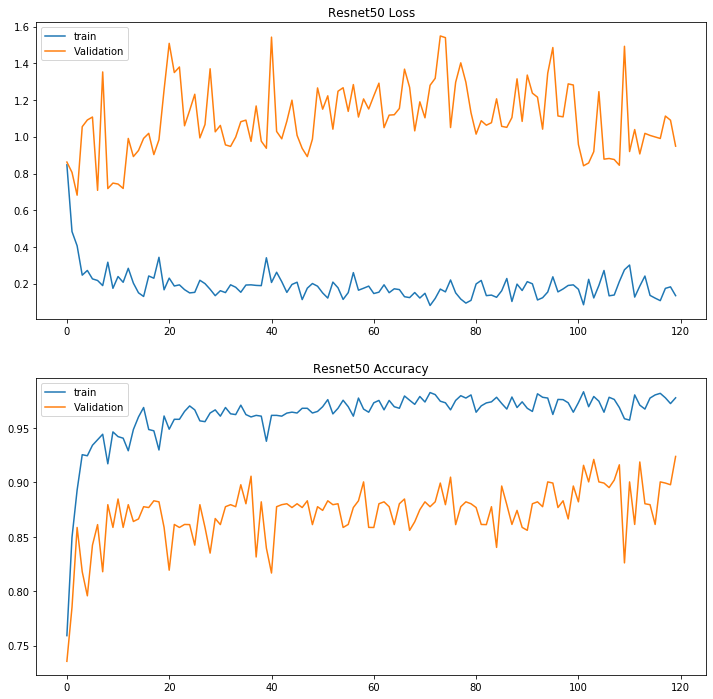

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Resnet50 Loss')
pyplot.plot(resnet50_history.history['loss'], label='train')
pyplot.plot(resnet50_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Resnet50 Accuracy')
pyplot.plot(resnet50_history.history['acc'], label='train')
pyplot.plot(resnet50_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
np.save('2020-2-20-Dr-Abass-Resnet50_model.npy',resnet50_history)
resnet50.save('2020-2-20-Dr-Abass-Resnet50_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.920, Test: 0.900


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.900000
Precision: 1.000000
Recall: 0.800000
F1 score: 0.888889


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.800000
ROC AUC: 0.900000
[[5 0]
 [1 4]]


#Xception

In [ ]:
NUM_CLASSES = 1

xception_model = Sequential()
xception_model.add(xception)
xception_model.add(layers.Dropout(0.3))
xception_model.add(layers.Flatten())
xception_model.add(layers.Dropout(0.5))
xception_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

xception_model.layers[0].trainable = False

xception_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)

xception_model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
xception (Model)             (None, 7, 7, 2048)        20861480  
_________________________________________________________________
dropout_13 (Dropout)         (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 100353    
Total params: 20,961,833
Trainable params: 100,353
Non-trainable params: 20,861,480
_________________________________________________________________


In [ ]:
import time

start = time.time()

xception_history = xception_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 38s 758ms/step - loss: 0.6168 - acc: 0.6976 - val_loss: 4.2146 - val_acc: 0.6204
Epoch 2/120
50/50 [==============================] - 23s 463ms/step - loss: 0.5218 - acc: 0.7608 - val_loss: 4.2212 - val_acc: 0.6196
Epoch 3/120
50/50 [==============================] - 23s 466ms/step - loss: 0.5049 - acc: 0.7685 - val_loss: 4.5515 - val_acc: 0.6152
Epoch 4/120
50/50 [==============================] - 23s 467ms/step - loss: 0.4210 - acc: 0.8172 - val_loss: 1.7724 - val_acc: 0.5842
Epoch 5/120
50/50 [==============================] - 24s 472ms/step - loss: 0.3694 - acc: 0.8581 - val_loss: 2.2213 - val_acc: 0.5628
Epoch 6/120
50/50 [==============================] - 24s 471ms/step - loss: 0.3872 - acc: 0.8364 - val_loss: 3.0880 - val_acc: 0.6196
Epoch 7/120
50/50 [==============================] - 25s 491ms/step - loss: 0.3650 - acc: 0.8617 - val_loss: 1.9355 - val_acc: 0.4241
Epoch 8/120
50/50 [==============================] - 23s 463ms

In [ ]:
# validate on val set
predictions = xception_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = xception_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = xception_model.evaluate(X_test_prep, y_test, verbose=0)


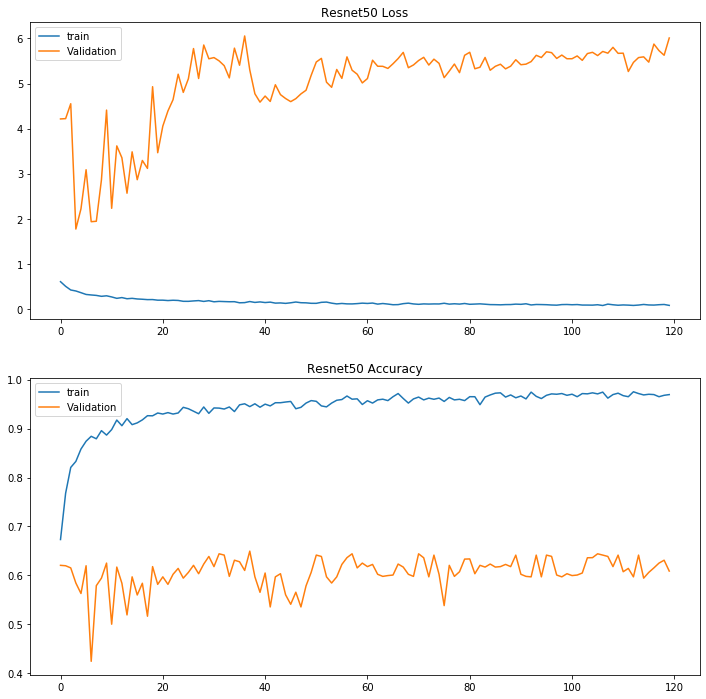

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Resnet50 Loss')
pyplot.plot(xception_history.history['loss'], label='train')
pyplot.plot(xception_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Resnet50 Accuracy')
pyplot.plot(xception_history.history['acc'], label='train')
pyplot.plot(xception_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
np.save('2020-2-20-Dr-Abass-Xception_model.npy',xception_history)
xception_model.save('2020-2-20-Dr-Abass-Xception_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.500


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 1.000000
F1 score: 0.666667


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[0 5]
 [0 5]]


#VGG19

In [ ]:
NUM_CLASSES = 1

vgg19_model = Sequential()
vgg19_model.add(vgg19)
vgg19_model.add(layers.Dropout(0.3))
vgg19_model.add(layers.Flatten())
vgg19_model.add(layers.Dropout(0.5))
vgg19_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg19_model.layers[0].trainable = False

vgg19_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
vgg19_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

vgg19_model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
dropout_3 (Dropout)          (None, 7, 7, 512)         0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________


In [ ]:
import time

start = time.time()

vgg19_history = vgg19_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)




Epoch 1/120
50/50 [==============================] - 27s 533ms/step - loss: 3.8432 - acc: 0.6302 - val_loss: 2.3849 - val_acc: 0.7565
Epoch 2/120
50/50 [==============================] - 21s 413ms/step - loss: 2.2837 - acc: 0.7760 - val_loss: 1.0230 - val_acc: 0.8804
Epoch 3/120
50/50 [==============================] - 21s 415ms/step - loss: 2.2139 - acc: 0.7555 - val_loss: 0.7979 - val_acc: 0.9267
Epoch 4/120
50/50 [==============================] - 21s 419ms/step - loss: 1.8425 - acc: 0.7921 - val_loss: 1.3298 - val_acc: 0.8723
Epoch 5/120
50/50 [==============================] - 21s 415ms/step - loss: 2.0261 - acc: 0.8191 - val_loss: 0.7508 - val_acc: 0.8979
Epoch 6/120
50/50 [==============================] - 21s 424ms/step - loss: 1.7394 - acc: 0.8247 - val_loss: 0.9699 - val_acc: 0.8859
Epoch 7/120
50/50 [==============================] - 23s 455ms/step - loss: 1.2056 - acc: 0.8790 - val_loss: 0.9213 - val_acc: 0.8770
Epoch 8/120
50/50 [==============================] - 21s 419

In [ ]:
# validate on val set
predictions = vgg19_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = vgg19_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = vgg19_model.evaluate(X_test_prep, y_test, verbose=0)

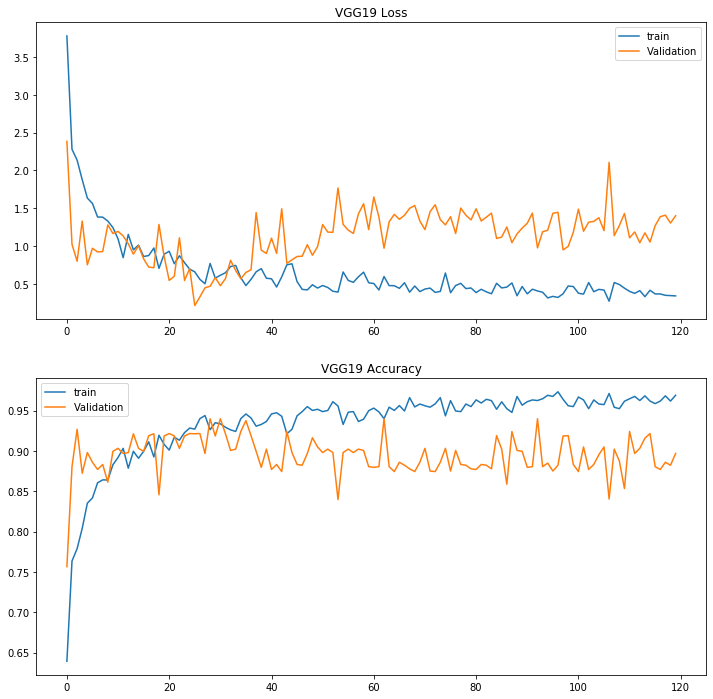

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('VGG19 Loss')
pyplot.plot(vgg19_history.history['loss'], label='train')
pyplot.plot(vgg19_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('VGG19 Accuracy')
pyplot.plot(vgg19_history.history['acc'], label='train')
pyplot.plot(vgg19_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
np.save('2020-2-20-Dr-Abass-VGG19_model.npy',vgg19_history)
vgg19_model.save('2020-2-20-Dr-Abass-VGG19_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.880, Test: 0.900


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.900000
Precision: 1.000000
Recall: 0.800000
F1 score: 0.888889


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.800000
ROC AUC: 0.900000
[[5 0]
 [1 4]]


#ResNet101

In [ ]:
NUM_CLASSES = 1

resnet101_model = Sequential()
resnet101_model.add(resnet101)
resnet101_model.add(layers.Dropout(0.3))
resnet101_model.add(layers.Flatten())
resnet101_model.add(layers.Dropout(0.5))
resnet101_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet101_model.layers[0].trainable = False

resnet101_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet101_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet101_model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet101 (Model)            (None, 7, 7, 2048)        42658176  
_________________________________________________________________
dropout_5 (Dropout)          (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 100353    
Total params: 42,758,529
Trainable params: 100,353
Non-trainable params: 42,658,176
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet101_history = resnet101_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 39s 774ms/step - loss: 0.7532 - acc: 0.7771 - val_loss: 0.8555 - val_acc: 0.8586
Epoch 2/120
50/50 [==============================] - 22s 434ms/step - loss: 0.5484 - acc: 0.8131 - val_loss: 0.5944 - val_acc: 0.8832
Epoch 3/120
50/50 [==============================] - 22s 439ms/step - loss: 0.4029 - acc: 0.8836 - val_loss: 0.9650 - val_acc: 0.7906
Epoch 4/120
50/50 [==============================] - 22s 436ms/step - loss: 0.2755 - acc: 0.9133 - val_loss: 0.7646 - val_acc: 0.8750
Epoch 5/120
50/50 [==============================] - 22s 435ms/step - loss: 0.4046 - acc: 0.9013 - val_loss: 0.5678 - val_acc: 0.8613
Epoch 6/120
50/50 [==============================] - 22s 437ms/step - loss: 0.2052 - acc: 0.9271 - val_loss: 0.6849 - val_acc: 0.8777
Epoch 7/120
50/50 [==============================] - 23s 460ms/step - loss: 0.6063 - acc: 0.8607 - val_loss: 0.6273 - val_acc: 0.8586
Epoch 8/120
50/50 [==============================] - 22s 436ms

In [ ]:
# validate on val set
predictions = resnet101_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet101_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet101_model.evaluate(X_test_prep, y_test, verbose=0)

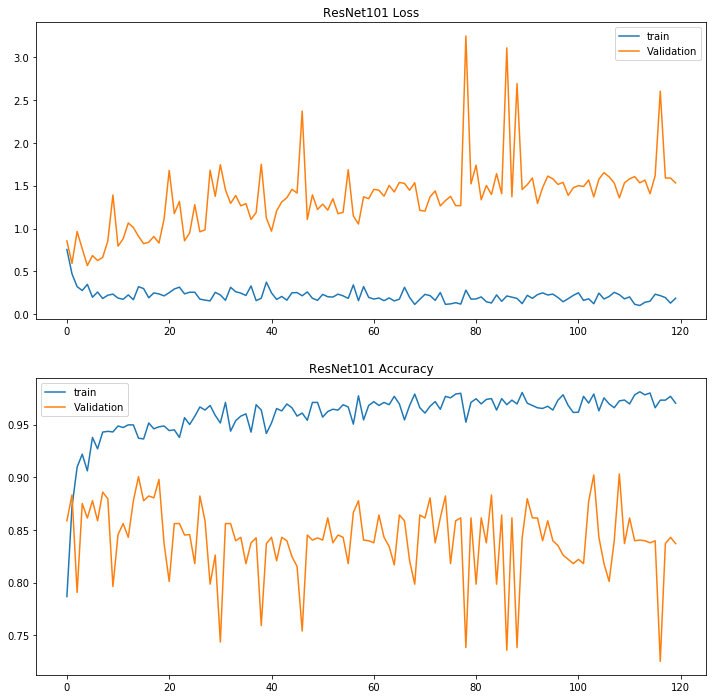

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('ResNet101 Loss')
pyplot.plot(resnet101_history.history['loss'], label='train')
pyplot.plot(resnet101_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('ResNet101 Accuracy')
pyplot.plot(resnet101_history.history['acc'], label='train')
pyplot.plot(resnet101_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
np.save('2020-2-20-Dr-Abass-ResNet101_model.npy',resnet101_history)
resnet101_model.save('2020-2-20-Dr-Abass-ResNet101_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.820, Test: 0.900


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.900000
Precision: 1.000000
Recall: 0.800000
F1 score: 0.888889


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.800000
ROC AUC: 0.900000
[[5 0]
 [1 4]]


#ResNet152

In [ ]:
NUM_CLASSES = 1

resnet152_model = Sequential()
resnet152_model.add(resnet152)
resnet152_model.add(layers.Dropout(0.3))
resnet152_model.add(layers.Flatten())
resnet152_model.add(layers.Dropout(0.5))
resnet152_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet152_model.layers[0].trainable = False

resnet152_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet152_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet152_model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet152 (Model)            (None, 7, 7, 2048)        58370944  
_________________________________________________________________
dropout_7 (Dropout)          (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_8 (Dropout)          (None, 100352)            0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 100353    
Total params: 58,471,297
Trainable params: 100,353
Non-trainable params: 58,370,944
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet152_history = resnet152_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 45s 893ms/step - loss: 0.8538 - acc: 0.7317 - val_loss: 1.3901 - val_acc: 0.6623
Epoch 2/120
50/50 [==============================] - 23s 455ms/step - loss: 0.5967 - acc: 0.8333 - val_loss: 2.1113 - val_acc: 0.6005
Epoch 3/120
50/50 [==============================] - 22s 448ms/step - loss: 0.4644 - acc: 0.8667 - val_loss: 0.7708 - val_acc: 0.8037
Epoch 4/120
50/50 [==============================] - 23s 462ms/step - loss: 0.4893 - acc: 0.8868 - val_loss: 0.9559 - val_acc: 0.7962
Epoch 5/120
50/50 [==============================] - 23s 451ms/step - loss: 0.5993 - acc: 0.8607 - val_loss: 0.3089 - val_acc: 0.9188
Epoch 6/120
50/50 [==============================] - 23s 458ms/step - loss: 0.4213 - acc: 0.8924 - val_loss: 1.6770 - val_acc: 0.6984
Epoch 7/120
50/50 [==============================] - 24s 476ms/step - loss: 0.2908 - acc: 0.9043 - val_loss: 0.4812 - val_acc: 0.9005
Epoch 8/120
50/50 [==============================] - 22s 447ms

In [ ]:
# validate on val set
predictions = resnet152_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet152_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet152_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
np.save('2020-2-20-Dr-Abass-ResNet152_model.npy',resnet152_history)
resnet152_model.save('2020-2-20-Dr-Abass-ResNet152_model.h5')

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.840, Test: 0.800


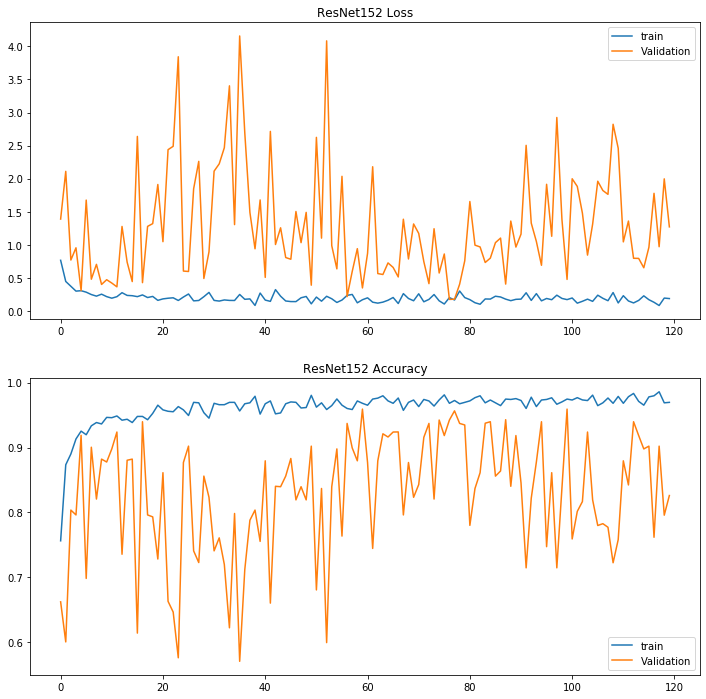

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('ResNet152 Loss')
pyplot.plot(resnet152_history.history['loss'], label='train')
pyplot.plot(resnet152_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('ResNet152 Accuracy')
pyplot.plot(resnet152_history.history['acc'], label='train')
pyplot.plot(resnet152_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.800000
Precision: 1.000000
Recall: 0.600000
F1 score: 0.750000


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.600000
ROC AUC: 0.800000
[[5 0]
 [2 3]]


#ResNet50V2

In [ ]:
NUM_CLASSES = 1

resnet50_v2_model = Sequential()
resnet50_v2_model.add(resnet50_v2)
resnet50_v2_model.add(layers.Dropout(0.3))
resnet50_v2_model.add(layers.Flatten())
resnet50_v2_model.add(layers.Dropout(0.5))
resnet50_v2_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet50_v2_model.layers[0].trainable = False

resnet50_v2_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet50_v2_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet50_v2_model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50v2 (Model)           (None, 7, 7, 2048)        23564800  
_________________________________________________________________
dropout_9 (Dropout)          (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 100353    
Total params: 23,665,153
Trainable params: 100,353
Non-trainable params: 23,564,800
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet50_v2_history = resnet50_v2_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 38s 764ms/step - loss: 0.8030 - acc: 0.6974 - val_loss: 6.0514 - val_acc: 0.6204
Epoch 2/120
50/50 [==============================] - 21s 413ms/step - loss: 0.4697 - acc: 0.8235 - val_loss: 6.0650 - val_acc: 0.6196
Epoch 3/120
50/50 [==============================] - 21s 412ms/step - loss: 0.5143 - acc: 0.8427 - val_loss: 6.1349 - val_acc: 0.6152
Epoch 4/120
50/50 [==============================] - 21s 421ms/step - loss: 0.4265 - acc: 0.8584 - val_loss: 5.9784 - val_acc: 0.6250
Epoch 5/120
50/50 [==============================] - 21s 418ms/step - loss: 0.4831 - acc: 0.8799 - val_loss: 6.0514 - val_acc: 0.6204
Epoch 6/120
50/50 [==============================] - 21s 415ms/step - loss: 0.2793 - acc: 0.9026 - val_loss: 6.0650 - val_acc: 0.6196
Epoch 7/120
50/50 [==============================] - 22s 443ms/step - loss: 0.2446 - acc: 0.9260 - val_loss: 6.0514 - val_acc: 0.6204
Epoch 8/120
50/50 [==============================] - 21s 420ms

In [ ]:
# validate on val set
predictions = resnet50_v2_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet50_v2_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet50_v2_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.500


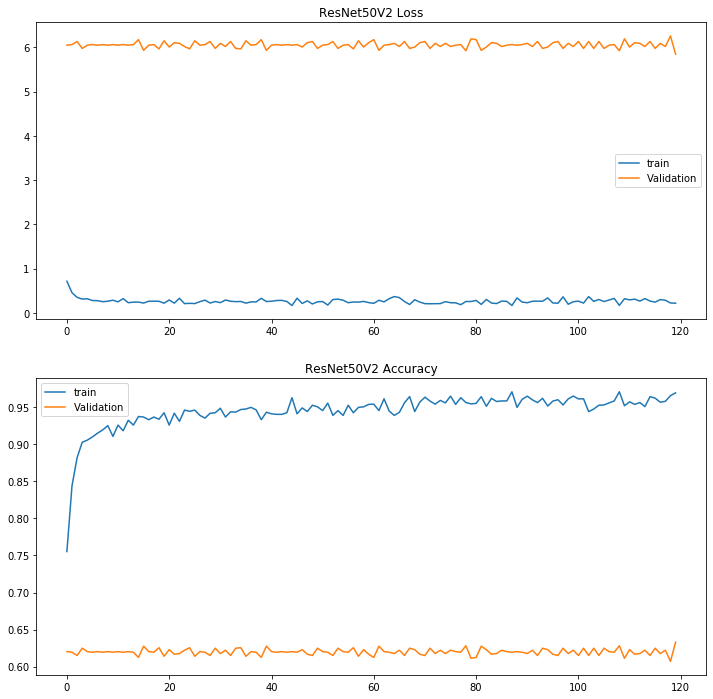

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('ResNet50V2 Loss')
pyplot.plot(resnet50_v2_history.history['loss'], label='train')
pyplot.plot(resnet50_v2_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('ResNet50V2 Accuracy')
pyplot.plot(resnet50_v2_history.history['acc'], label='train')
pyplot.plot(resnet50_v2_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 1.000000
F1 score: 0.666667


In [ ]:

kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[0 5]
 [0 5]]


In [ ]:
np.save('2020-2-20-Dr-Abass-ResNet50V2_model.npy',resnet50_v2_history)
resnet50_v2_model.save('2020-2-20-Dr-Abass-ResNet50V2_model.h5')

#ResNet101V2

In [ ]:
NUM_CLASSES = 1

resnet101_v2_model = Sequential()
resnet101_v2_model.add(resnet101_v2)
resnet101_v2_model.add(layers.Dropout(0.3))
resnet101_v2_model.add(layers.Flatten())
resnet101_v2_model.add(layers.Dropout(0.5))
resnet101_v2_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet101_v2_model.layers[0].trainable = False

resnet101_v2_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet101_v2_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet101_v2_model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet101v2 (Model)          (None, 7, 7, 2048)        42626560  
_________________________________________________________________
dropout_11 (Dropout)         (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_6 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 100353    
Total params: 42,726,913
Trainable params: 100,353
Non-trainable params: 42,626,560
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet101_v2_model_history = resnet101_v2_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 42s 840ms/step - loss: 0.8995 - acc: 0.7004 - val_loss: 5.9680 - val_acc: 0.6257
Epoch 2/120
50/50 [==============================] - 22s 433ms/step - loss: 0.5612 - acc: 0.7969 - val_loss: 6.1517 - val_acc: 0.6141
Epoch 3/120
50/50 [==============================] - 22s 431ms/step - loss: 0.4238 - acc: 0.8420 - val_loss: 5.9680 - val_acc: 0.6257
Epoch 4/120
50/50 [==============================] - 22s 434ms/step - loss: 0.4989 - acc: 0.8338 - val_loss: 6.1517 - val_acc: 0.6141
Epoch 5/120
50/50 [==============================] - 22s 440ms/step - loss: 0.4335 - acc: 0.8608 - val_loss: 6.0514 - val_acc: 0.6204
Epoch 6/120
50/50 [==============================] - 22s 439ms/step - loss: 0.2838 - acc: 0.9014 - val_loss: 6.0650 - val_acc: 0.6196
Epoch 7/120
50/50 [==============================] - 23s 460ms/step - loss: 0.3233 - acc: 0.8792 - val_loss: 6.0514 - val_acc: 0.6204
Epoch 8/120
50/50 [==============================] - 22s 438ms

In [ ]:
# validate on val set
predictions = resnet101_v2_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet101_v2_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet101_v2_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.500


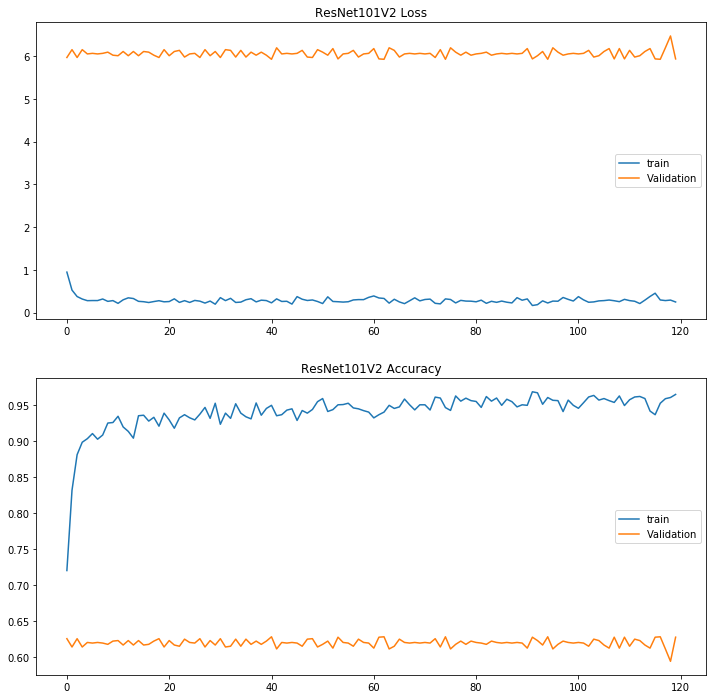

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('ResNet101V2 Loss')
pyplot.plot(resnet101_v2_model_history.history['loss'], label='train')
pyplot.plot(resnet101_v2_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('ResNet101V2 Accuracy')
pyplot.plot(resnet101_v2_model_history.history['acc'], label='train')
pyplot.plot(resnet101_v2_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 1.000000
F1 score: 0.666667


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[0 5]
 [0 5]]


In [ ]:
np.save('2020-2-20-Dr-Abass-ResNet101V2_model.npy',resnet101_v2_model_history)
resnet101_v2_model.save('2020-2-20-Dr-Abass-ResNet101V2_model.h5')

#ResNet152V2

In [ ]:
NUM_CLASSES = 1

resnet152_v2_model = Sequential()
resnet152_v2_model.add(resnet152_v2)
resnet152_v2_model.add(layers.Dropout(0.3))
resnet152_v2_model.add(layers.Flatten())
resnet152_v2_model.add(layers.Dropout(0.5))
resnet152_v2_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet152_v2_model.layers[0].trainable = False

resnet152_v2_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
resnet152_v2_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

resnet152_v2_model.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet152v2 (Model)          (None, 7, 7, 2048)        58331648  
_________________________________________________________________
dropout_13 (Dropout)         (None, 7, 7, 2048)        0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 100352)            0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 100352)            0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 100353    
Total params: 58,432,001
Trainable params: 100,353
Non-trainable params: 58,331,648
_________________________________________________________________


In [ ]:
import time

start = time.time()

resnet152_v2_model_history = resnet152_v2_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 50s 991ms/step - loss: 0.9232 - acc: 0.6971 - val_loss: 6.1766 - val_acc: 0.6126
Epoch 2/120
50/50 [==============================] - 22s 441ms/step - loss: 0.5354 - acc: 0.8017 - val_loss: 5.9351 - val_acc: 0.6277
Epoch 3/120
50/50 [==============================] - 23s 454ms/step - loss: 0.4843 - acc: 0.8239 - val_loss: 6.1766 - val_acc: 0.6126
Epoch 4/120
50/50 [==============================] - 22s 447ms/step - loss: 0.3810 - acc: 0.8738 - val_loss: 5.9351 - val_acc: 0.6277
Epoch 5/120
50/50 [==============================] - 23s 467ms/step - loss: 0.3219 - acc: 0.8849 - val_loss: 5.9680 - val_acc: 0.6257
Epoch 6/120
50/50 [==============================] - 23s 460ms/step - loss: 0.4620 - acc: 0.8521 - val_loss: 6.1517 - val_acc: 0.6141
Epoch 7/120
50/50 [==============================] - 24s 479ms/step - loss: 0.3301 - acc: 0.9102 - val_loss: 6.1766 - val_acc: 0.6126
Epoch 8/120
50/50 [==============================] - 23s 450ms

In [ ]:
# validate on val set
predictions = resnet152_v2_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = resnet152_v2_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = resnet152_v2_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.500


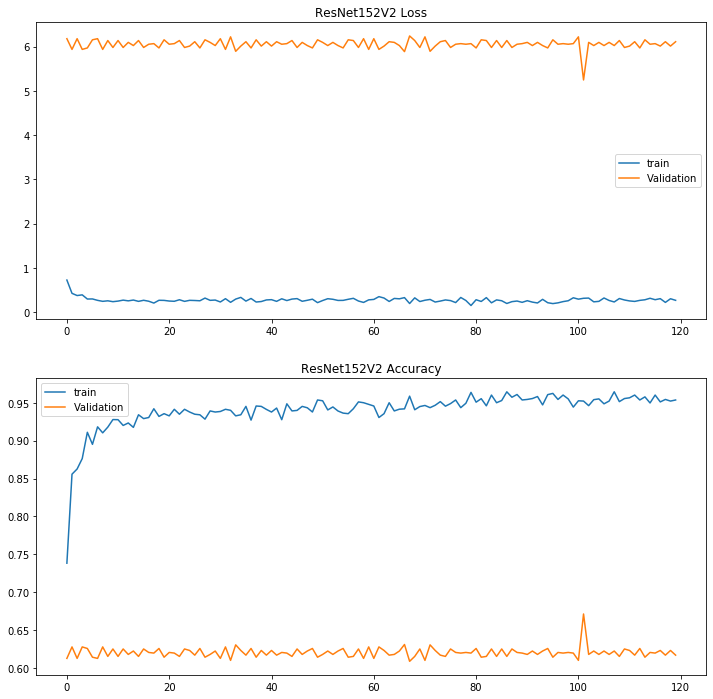

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('ResNet152V2 Loss')
pyplot.plot(resnet152_v2_model_history.history['loss'], label='train')
pyplot.plot(resnet152_v2_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('ResNet152V2 Accuracy')
pyplot.plot(resnet152_v2_model_history.history['acc'], label='train')
pyplot.plot(resnet152_v2_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 1.000000
F1 score: 0.666667


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[0 5]
 [0 5]]


In [ ]:
np.save('2020-2-20-Dr-Abass-ResNet152V2_model.npy',resnet152_v2_model_history)
resnet152_v2_model.save('2020-2-20-Dr-Abass-ResNet152V2_model.h5')

#InceptionResNetV2

In [ ]:
NUM_CLASSES = 1

inceptionResNetV2_model = Sequential()
inceptionResNetV2_model.add(inceptionResNetV2)
inceptionResNetV2_model.add(layers.Dropout(0.3))
inceptionResNetV2_model.add(layers.Flatten())
inceptionResNetV2_model.add(layers.Dropout(0.5))
inceptionResNetV2_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

inceptionResNetV2_model.layers[0].trainable = False

inceptionResNetV2_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
inceptionResNetV2_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

inceptionResNetV2_model.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_resnet_v2 (Model)  (None, 5, 5, 1536)        54336736  
_________________________________________________________________
dropout_15 (Dropout)         (None, 5, 5, 1536)        0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 38400)             0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 38400)             0         
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 38401     
Total params: 54,375,137
Trainable params: 38,401
Non-trainable params: 54,336,736
_________________________________________________________________


In [ ]:
import time

start = time.time()

inceptionResNetV2_model_history = inceptionResNetV2_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 59s 1s/step - loss: 0.6308 - acc: 0.7207 - val_loss: 6.1349 - val_acc: 0.6152
Epoch 2/120
50/50 [==============================] - 23s 451ms/step - loss: 0.5112 - acc: 0.7241 - val_loss: 6.8905 - val_acc: 0.5462
Epoch 3/120
50/50 [==============================] - 23s 462ms/step - loss: 0.4713 - acc: 0.7850 - val_loss: 9.9156 - val_acc: 0.3848
Epoch 4/120
50/50 [==============================] - 25s 506ms/step - loss: 0.5406 - acc: 0.7471 - val_loss: 10.0738 - val_acc: 0.3750
Epoch 5/120
50/50 [==============================] - 24s 476ms/step - loss: 0.4676 - acc: 0.7806 - val_loss: 8.9035 - val_acc: 0.4424
Epoch 6/120
50/50 [==============================] - 23s 463ms/step - loss: 0.4576 - acc: 0.8249 - val_loss: 7.6171 - val_acc: 0.5082
Epoch 7/120
50/50 [==============================] - 24s 482ms/step - loss: 0.4342 - acc: 0.8114 - val_loss: 9.9156 - val_acc: 0.3848
Epoch 8/120
50/50 [==============================] - 22s 445ms/s

In [ ]:
# validate on val set
predictions = inceptionResNetV2_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = inceptionResNetV2_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = inceptionResNetV2_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.500


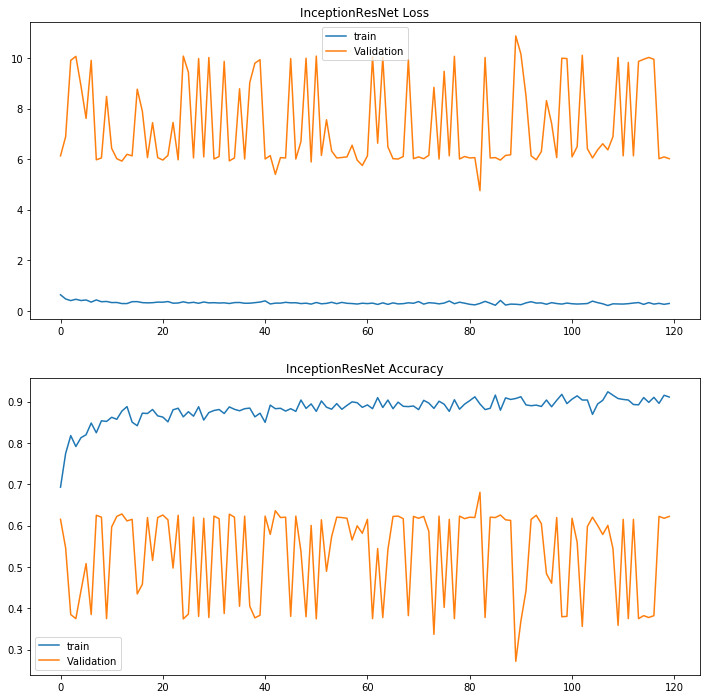

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('InceptionResNet Loss')
pyplot.plot(inceptionResNetV2_model_history.history['loss'], label='train')
pyplot.plot(inceptionResNetV2_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('InceptionResNet Accuracy')
pyplot.plot(inceptionResNetV2_model_history.history['acc'], label='train')
pyplot.plot(inceptionResNetV2_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.500000
Precision: 0.500000
Recall: 1.000000
F1 score: 0.666667


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.000000
ROC AUC: 0.500000
[[0 5]
 [0 5]]


In [ ]:
np.save('2020-2-20-Dr-Abass-InceptionResNet_model.npy',inceptionResNetV2_model_history)
inceptionResNetV2_model.save('2020-2-20-Dr-Abass-InceptionResNet_model.h5')

# MobileNet

In [ ]:
NUM_CLASSES = 1

mobileNet_model = Sequential()
mobileNet_model.add(mobileNet)
mobileNet_model.add(layers.Dropout(0.3))
mobileNet_model.add(layers.Flatten())
mobileNet_model.add(layers.Dropout(0.5))
mobileNet_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

mobileNet_model.layers[0].trainable = False

mobileNet_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
mobileNet_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

mobileNet_model.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenet_1.00_224 (Model)   (None, 7, 7, 1024)        3228864   
_________________________________________________________________
dropout_17 (Dropout)         (None, 7, 7, 1024)        0         
_________________________________________________________________
flatten_9 (Flatten)          (None, 50176)             0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 50176)             0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 50177     
Total params: 3,279,041
Trainable params: 50,177
Non-trainable params: 3,228,864
_________________________________________________________________


In [ ]:
import time

start = time.time()

mobileNet_model_history = mobileNet_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 53s 1s/step - loss: 0.8781 - acc: 0.6648 - val_loss: 0.8628 - val_acc: 0.7173
Epoch 2/120
50/50 [==============================] - 20s 401ms/step - loss: 0.7134 - acc: 0.8310 - val_loss: 1.2316 - val_acc: 0.6033
Epoch 3/120
50/50 [==============================] - 21s 427ms/step - loss: 0.4059 - acc: 0.8663 - val_loss: 0.8924 - val_acc: 0.7565
Epoch 4/120
50/50 [==============================] - 21s 418ms/step - loss: 0.7279 - acc: 0.8237 - val_loss: 0.8338 - val_acc: 0.7799
Epoch 5/120
50/50 [==============================] - 21s 421ms/step - loss: 0.5341 - acc: 0.8609 - val_loss: 1.4539 - val_acc: 0.6440
Epoch 6/120
50/50 [==============================] - 21s 424ms/step - loss: 0.5816 - acc: 0.8375 - val_loss: 1.7098 - val_acc: 0.6332
Epoch 7/120
50/50 [==============================] - 22s 442ms/step - loss: 0.3761 - acc: 0.8369 - val_loss: 1.0606 - val_acc: 0.7592
Epoch 8/120
50/50 [==============================] - 21s 423ms/st

In [ ]:
# validate on val set
predictions = mobileNet_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = mobileNet_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = mobileNet_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.700, Test: 0.600


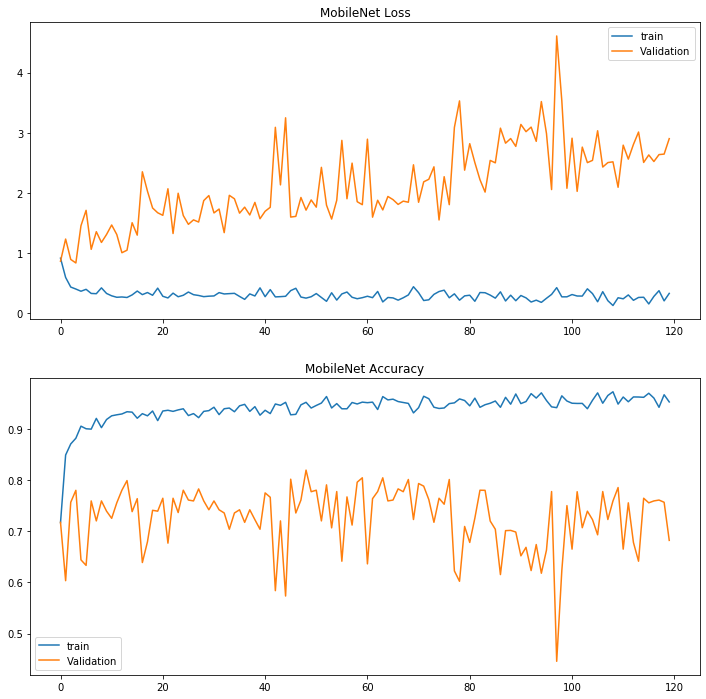

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('MobileNet Loss')
pyplot.plot(mobileNet_model_history.history['loss'], label='train')
pyplot.plot(mobileNet_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('MobileNet Accuracy')
pyplot.plot(mobileNet_model_history.history['acc'], label='train')
pyplot.plot(mobileNet_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.600000
Precision: 1.000000
Recall: 0.200000
F1 score: 0.333333


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.200000
ROC AUC: 0.600000
[[5 0]
 [4 1]]


In [ ]:
np.save('2020-2-20-Dr-Abass-MobileNet_model.npy',mobileNet_model_history)
mobileNet_model.save('2020-2-20-Dr-Abass-MobileNet_model.h5')

# MobileNetV2

In [ ]:
NUM_CLASSES = 1

mobileNetV2_model = Sequential()
mobileNetV2_model.add(mobileNetV2)
mobileNetV2_model.add(layers.Dropout(0.3))
mobileNetV2_model.add(layers.Flatten())
mobileNetV2_model.add(layers.Dropout(0.5))
mobileNetV2_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

mobileNetV2_model.layers[0].trainable = False

mobileNetV2_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
mobileNetV2_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

mobileNetV2_model.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_224 (Model) (None, 7, 7, 1280)        2257984   
_________________________________________________________________
dropout_19 (Dropout)         (None, 7, 7, 1280)        0         
_________________________________________________________________
flatten_10 (Flatten)         (None, 62720)             0         
_________________________________________________________________
dropout_20 (Dropout)         (None, 62720)             0         
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 62721     
Total params: 2,320,705
Trainable params: 62,721
Non-trainable params: 2,257,984
_________________________________________________________________


In [ ]:
import time

start = time.time()

mobileNet_model_historyv2 = mobileNetV2_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 56s 1s/step - loss: 1.0041 - acc: 0.6618 - val_loss: 0.7023 - val_acc: 0.8246
Epoch 2/120
50/50 [==============================] - 20s 405ms/step - loss: 0.4938 - acc: 0.8140 - val_loss: 0.8208 - val_acc: 0.7147
Epoch 3/120
50/50 [==============================] - 21s 425ms/step - loss: 0.6619 - acc: 0.7552 - val_loss: 0.9350 - val_acc: 0.7408
Epoch 4/120
50/50 [==============================] - 22s 430ms/step - loss: 0.4969 - acc: 0.8201 - val_loss: 1.1275 - val_acc: 0.6005
Epoch 5/120
50/50 [==============================] - 22s 432ms/step - loss: 0.4610 - acc: 0.8492 - val_loss: 0.8217 - val_acc: 0.7330
Epoch 6/120
50/50 [==============================] - 22s 434ms/step - loss: 0.5049 - acc: 0.8483 - val_loss: 0.7741 - val_acc: 0.7636
Epoch 7/120
50/50 [==============================] - 23s 452ms/step - loss: 0.3845 - acc: 0.8742 - val_loss: 0.8826 - val_acc: 0.7461
Epoch 8/120
50/50 [==============================] - 22s 430ms/st

In [ ]:
# validate on val set
predictions = mobileNetV2_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = mobileNetV2_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = mobileNetV2_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.700, Test: 0.700


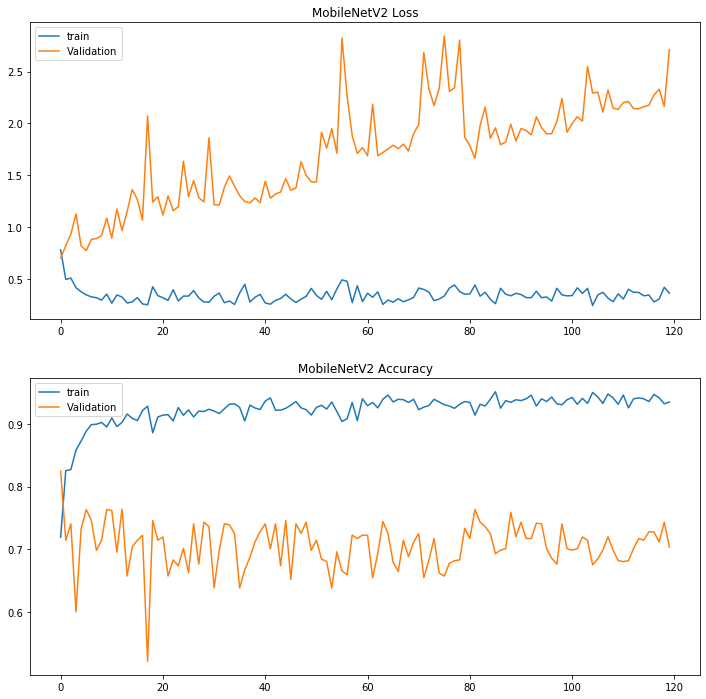

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('MobileNetV2 Loss')
pyplot.plot(mobileNet_model_historyv2.history['loss'], label='train')
pyplot.plot(mobileNet_model_historyv2.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('MobileNetV2 Accuracy')
pyplot.plot(mobileNet_model_historyv2.history['acc'], label='train')
pyplot.plot(mobileNet_model_historyv2.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.700000
Precision: 0.625000
Recall: 1.000000
F1 score: 0.769231


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.400000
ROC AUC: 0.700000
[[2 3]
 [0 5]]


In [ ]:
np.save('2020-2-20-Dr-Abass-MobileNetV2_model.npy',mobileNet_model_historyv2)
mobileNetV2_model.save('2020-2-20-Dr-Abass-MobileNetV2_model.h5')

#DenseNet

In [ ]:
NUM_CLASSES = 1

DenseNet121_model = Sequential()
DenseNet121_model.add(denseNet121)
DenseNet121_model.add(layers.Dropout(0.3))
DenseNet121_model.add(layers.Flatten())
DenseNet121_model.add(layers.Dropout(0.5))
DenseNet121_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

DenseNet121_model.layers[0].trainable = False

DenseNet121_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
DenseNet121_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

DenseNet121_model.summary()

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
densenet121 (Model)          (None, 7, 7, 1024)        7037504   
_________________________________________________________________
dropout_21 (Dropout)         (None, 7, 7, 1024)        0         
_________________________________________________________________
flatten_11 (Flatten)         (None, 50176)             0         
_________________________________________________________________
dropout_22 (Dropout)         (None, 50176)             0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 50177     
Total params: 7,087,681
Trainable params: 50,177
Non-trainable params: 7,037,504
_________________________________________________________________


In [ ]:
import time

start = time.time()

DenseNet121_model_history = DenseNet121_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 61s 1s/step - loss: 0.9048 - acc: 0.7035 - val_loss: 5.0585 - val_acc: 0.4791
Epoch 2/120
50/50 [==============================] - 22s 433ms/step - loss: 0.6405 - acc: 0.7838 - val_loss: 2.8134 - val_acc: 0.6033
Epoch 3/120
50/50 [==============================] - 22s 437ms/step - loss: 0.4817 - acc: 0.8180 - val_loss: 3.1943 - val_acc: 0.6649
Epoch 4/120
50/50 [==============================] - 22s 435ms/step - loss: 0.9090 - acc: 0.7729 - val_loss: 3.0507 - val_acc: 0.6168
Epoch 5/120
50/50 [==============================] - 22s 434ms/step - loss: 0.8063 - acc: 0.8001 - val_loss: 3.6039 - val_acc: 0.5812
Epoch 6/120
50/50 [==============================] - 22s 443ms/step - loss: 0.3786 - acc: 0.8903 - val_loss: 4.5731 - val_acc: 0.6386
Epoch 7/120
50/50 [==============================] - 23s 461ms/step - loss: 0.4743 - acc: 0.8107 - val_loss: 3.4674 - val_acc: 0.5995
Epoch 8/120
50/50 [==============================] - 21s 428ms/st

In [ ]:
# validate on val set
predictions = DenseNet121_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = DenseNet121_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = DenseNet121_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.440, Test: 0.600


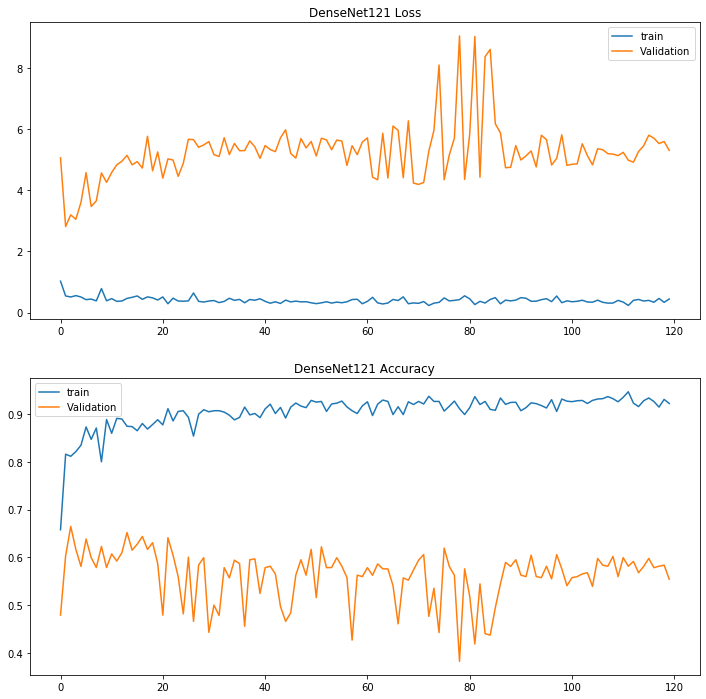

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('DenseNet121 Loss')
pyplot.plot(DenseNet121_model_history.history['loss'], label='train')
pyplot.plot(DenseNet121_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('DenseNet121 Accuracy')
pyplot.plot(DenseNet121_model_history.history['acc'], label='train')
pyplot.plot(DenseNet121_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.600000
Precision: 0.666667
Recall: 0.400000
F1 score: 0.500000


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.200000
ROC AUC: 0.600000
[[4 1]
 [3 2]]


In [ ]:
np.save('2020-2-20-Dr-Abass-DenseNet121_model.npy',DenseNet121_model_history)
DenseNet121_model.save('2020-2-20-Dr-Abass-DenseNet121_model.h5')

#NASNetMobile

In [ ]:
NUM_CLASSES = 1

nASNetMobile_model = Sequential()
nASNetMobile_model.add(nASNetMobile)
nASNetMobile_model.add(layers.Dropout(0.3))
nASNetMobile_model.add(layers.Flatten())
nASNetMobile_model.add(layers.Dropout(0.5))
nASNetMobile_model.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

nASNetMobile_model.layers[0].trainable = False

nASNetMobile_model.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)
nASNetMobile_model.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False), metrics=["accuracy"])

nASNetMobile_model.summary()

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 7, 7, 1056)        4269716   
_________________________________________________________________
dropout_23 (Dropout)         (None, 7, 7, 1056)        0         
_________________________________________________________________
flatten_12 (Flatten)         (None, 51744)             0         
_________________________________________________________________
dropout_24 (Dropout)         (None, 51744)             0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 51745     
Total params: 4,321,461
Trainable params: 51,745
Non-trainable params: 4,269,716
_________________________________________________________________


In [ ]:
import time

start = time.time()

nASNetMobile_model_model_history = nASNetMobile_model.fit_generator(
    train_generator,
    steps_per_epoch=50,
    epochs=120,
    validation_data=validation_generator,
    validation_steps=30,
)

end = time.time()
print(end - start)

Epoch 1/120
50/50 [==============================] - 68s 1s/step - loss: 0.8689 - acc: 0.6810 - val_loss: 4.9251 - val_acc: 0.4110
Epoch 2/120
50/50 [==============================] - 22s 437ms/step - loss: 0.6653 - acc: 0.7380 - val_loss: 4.8908 - val_acc: 0.4674
Epoch 3/120
50/50 [==============================] - 22s 439ms/step - loss: 0.7105 - acc: 0.7593 - val_loss: 4.5337 - val_acc: 0.4241
Epoch 4/120
50/50 [==============================] - 22s 440ms/step - loss: 0.7413 - acc: 0.7556 - val_loss: 4.9350 - val_acc: 0.3995
Epoch 5/120
50/50 [==============================] - 22s 436ms/step - loss: 0.7083 - acc: 0.7780 - val_loss: 4.9913 - val_acc: 0.3796
Epoch 6/120
50/50 [==============================] - 22s 441ms/step - loss: 0.6871 - acc: 0.7927 - val_loss: 5.4295 - val_acc: 0.4484
Epoch 7/120
50/50 [==============================] - 23s 458ms/step - loss: 0.6687 - acc: 0.7951 - val_loss: 5.1210 - val_acc: 0.4450
Epoch 8/120
50/50 [==============================] - 22s 440ms/st

In [ ]:
# validate on val set
predictions = nASNetMobile_model.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

train_acc = nASNetMobile_model.evaluate(X_val_prep, y_val, verbose=0)
test_acc = nASNetMobile_model.evaluate(X_test_prep, y_test, verbose=0)

In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc[1], test_acc[1]))

Train: 0.620, Test: 0.700


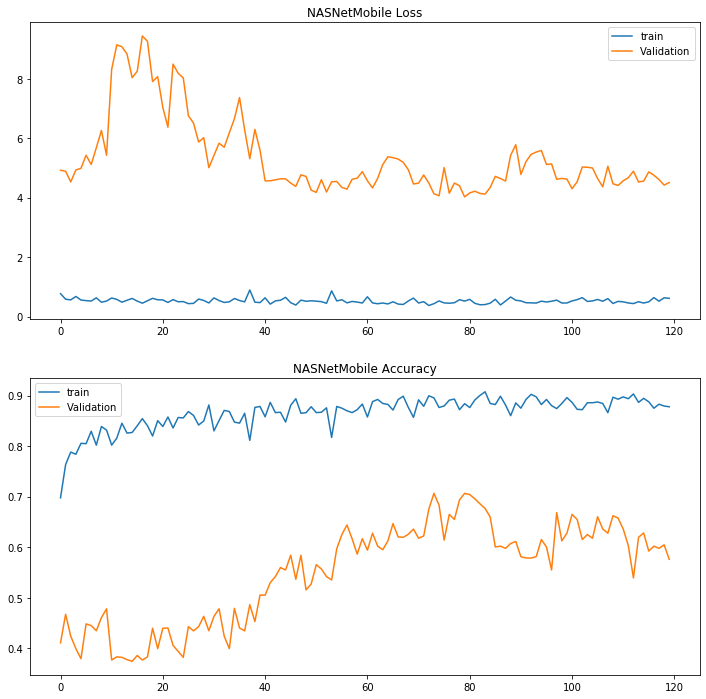

In [ ]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('NASNetMobile Loss')
pyplot.plot(nASNetMobile_model_model_history.history['loss'], label='train')
pyplot.plot(nASNetMobile_model_model_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('NASNetMobile Accuracy')
pyplot.plot(nASNetMobile_model_model_history.history['acc'], label='train')
pyplot.plot(nASNetMobile_model_model_history.history['val_acc'], label='Validation')
pyplot.legend()
pyplot.show()

In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.700000
Precision: 0.666667
Recall: 0.800000
F1 score: 0.727273


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.400000
ROC AUC: 0.700000
[[3 2]
 [1 4]]


In [ ]:
np.save('2020-2-20-Dr-Abass-NASNetMobile_model.npy',nASNetMobile_model_model_history)
nASNetMobile_model.save('2020-2-20-Dr-Abass-NASNetMobile_model.h5')

## <a id='perf'>4.3. Model Performance</a>

In [ ]:
history_1= vgg16_history
history_2=inception_v3_history
history_3=resnet50_history

In [ ]:
def ModelGraphTrainngSummary(history,N,model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib
    print("Generating plots...")
    sys.stdout.flush()
    matplotlib.use("Agg")
    matplotlib.pyplot.style.use("ggplot")
    matplotlib.pyplot.figure()
    matplotlib.pyplot.plot(np.arange(0, N), history.history["loss"], label="train_loss")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["val_loss"], label="val_loss")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["acc"], label="train_acc")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["val_acc"], label="val_acc")
    matplotlib.pyplot.title("Training Loss and Accuracy on Brain Tumor Classification")
    matplotlib.pyplot.xlabel("Epoch #")
    matplotlib.pyplot.ylabel("Loss/Accuracy of "+model_name)
    matplotlib.pyplot.legend(loc="lower left")
    matplotlib.pyplot.savefig("plot.png")

In [ ]:
def ModelGraphTrainngSummaryAcc(history,N,model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib
    print("Generating plots...")
    sys.stdout.flush()
    matplotlib.use("Agg")
    matplotlib.pyplot.style.use("ggplot")
    matplotlib.pyplot.figure()
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["loss"], label="train_loss")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["val_loss"], label="val_loss")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["acc"], label="train_acc")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["val_acc"], label="val_acc")
    matplotlib.pyplot.title("Training Loss and Accuracy on Brain Tumor Classification")
    matplotlib.pyplot.xlabel("Epoch #")
    matplotlib.pyplot.ylabel("Accuracy of "+ model_name)
    matplotlib.pyplot.legend(loc="lower left")
    matplotlib.pyplot.savefig("plot.png")

In [ ]:
for x_model in [{'name':'VGG-16','history':history_1,'model':vgg16},
                {'name':'Inception_v3','history':history_2,'model':inception_v3},
                {'name':'Resnet','history':history_3,'model':resnet50}]:
    ModelGraphTrainngSummary(x_model['history'],120,x_model['name'])
    ModelGraphTrainngSummaryAcc(x_model['history'],120,x_model['name'])
    
    # validate on val set
    predictions = x_model['model'].predict(X_val_prep)
    predictions = [1 if x>0.5 else 0 for x in predictions]

    accuracy = accuracy_score(y_val, predictions)
    print('Val Accuracy = %.2f' % accuracy)

    confusion_mtx = confusion_matrix(y_val, predictions) 
    cm = plot_confusion_matrix(confusion_mtx, classes = list(labels.items()), normalize=False)

# <a id='concl'>5. Mask_RCNN</a>
For doing this I've added annotations for scans with VGG Image Annotator (VIA) (just the yes folder obviously). I haven't realized that this data set is such a mess. It has a lot of duplicated scans which I tried to remove (not sure that I've removed all of the duplicates though). To make it easy for myself I've added new dataset to GitHub Repo which contains of following folders: annotations and train, val, test images.

There were some issues with annotations. I couldn't visually detect tumor on some of the scans from yes folder (could be caused by the fact that I am not a radiologist or the dataset is not properly assigned). Also on some scans I couldn't figure out which area should be labelled as tumor since it was vague. However, this project is just an example of how you can deal with such task and I will improve it as soon I get more expertise.

# <a id='concl'>5.1 Setting up the Environment</a>

In [ ]:
from IPython.display import clear_output
!git clone https://github.com/matterport/Mask_RCNN.git # load Mask R-CNN code implementation
!git clone https://github.com/ruslan-kl/brain-tumor.git # load new data set and annotations 
!pip install pycocotools

!rm -rf brain-tumor/.git/
!rm -rf Mask_RCNN/.git/

clear_output()

In [ ]:
import os 
import sys
from tqdm import tqdm
import cv2
import numpy as np
import json
import skimage.draw
import matplotlib
import matplotlib.pyplot as plt
import random

# Root directory of the project
ROOT_DIR = os.path.abspath('Mask_RCNN/')
# Import Mask RCNN
sys.path.append(ROOT_DIR) 
from mrcnn.config import Config
from mrcnn import utils
from mrcnn.model import log
import mrcnn.model as modellib
from mrcnn import visualize
# Import COCO config
sys.path.append(os.path.join(ROOT_DIR, 'samples/coco/'))
import coco

plt.rcParams['figure.facecolor'] = 'white'

clear_output()

In [ ]:
def get_ax(rows=1, cols=1, size=7):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Change the default size attribute to control the size
    of rendered images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

In [ ]:
MODEL_DIR = os.path.join(ROOT_DIR, 'logs') # directory to save logs and trained model
# ANNOTATIONS_DIR = 'brain-tumor/data/new/annotations/' # directory with annotations for train/val sets
DATASET_DIR = 'brain-tumor/data_cleaned/' # directory with image data
DEFAULT_LOGS_DIR = 'logs' 

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

... done downloading pretrained model!


In [ ]:
class TumorConfig(Config):
    """Configuration for training on the brain tumor dataset.
    """
    # Give the configuration a recognizable name
    NAME = 'tumor_detector'
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    NUM_CLASSES = 1 + 1  # background + tumor
    DETECTION_MIN_CONFIDENCE = 0.85    
    STEPS_PER_EPOCH = 100
    LEARNING_RATE = 0.001
    
config = TumorConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.85
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE        

In [ ]:
class BrainScanDataset(utils.Dataset):

    def load_brain_scan(self, dataset_dir, subset):
        """Load a subset of the FarmCow dataset.
        dataset_dir: Root directory of the dataset.
        subset: Subset to load: train or val
        """
        # Add classes. We have only one class to add.
        self.add_class("tumor", 1, "tumor")

        # Train or validation dataset?
        assert subset in ["train", "val", 'test']
        dataset_dir = os.path.join(dataset_dir, subset)

        annotations = json.load(open(os.path.join(DATASET_DIR, subset, 'annotations_'+subset+'.json')))
        annotations = list(annotations.values())  # don't need the dict keys

        # The VIA tool saves images in the JSON even if they don't have any
        # annotations. Skip unannotated images.
        annotations = [a for a in annotations if a['regions']]

        # Add images
        for a in annotations:
            # Get the x, y coordinaets of points of the polygons that make up
            # the outline of each object instance. These are stores in the
            # shape_attributes (see json format above)
            # The if condition is needed to support VIA versions 1.x and 2.x.
            if type(a['regions']) is dict:
                polygons = [r['shape_attributes'] for r in a['regions'].values()]
            else:
                polygons = [r['shape_attributes'] for r in a['regions']]

            # load_mask() needs the image size to convert polygons to masks.
            # Unfortunately, VIA doesn't include it in JSON, so we must read
            # the image. This is only managable since the dataset is tiny.
            image_path = os.path.join(dataset_dir, a['filename'])
            image = skimage.io.imread(image_path)
            height, width = image.shape[:2]

            self.add_image(
                "tumor",
                image_id=a['filename'],  # use file name as a unique image id
                path=image_path,
                width=width, 
                height=height,
                polygons=polygons
            )

    def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        # If not a farm_cow dataset image, delegate to parent class.
        image_info = self.image_info[image_id]
        if image_info["source"] != "tumor":
            return super(self.__class__, self).load_mask(image_id)

        # Convert polygons to a bitmap mask of shape
        # [height, width, instance_count]
        info = self.image_info[image_id]
        mask = np.zeros([info["height"], info["width"], len(info["polygons"])],
                        dtype=np.uint8)
        for i, p in enumerate(info["polygons"]):
            # Get indexes of pixels inside the polygon and set them to 1
            rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])
            mask[rr, cc, i] = 1

        # Return mask, and array of class IDs of each instance. Since we have
        # one class ID only, we return an array of 1s
        return mask.astype(np.bool), np.ones([mask.shape[-1]], dtype=np.int32)

    def image_reference(self, image_id):
        """Return the path of the image."""
        info = self.image_info[image_id]
        if info["source"] == "tumor":
            return info["path"]
        else:
            super(self.__class__, self).image_reference(image_id)


# <a id='concl'>5.2 Mask R-CNN Model</a>

In [ ]:
model = modellib.MaskRCNN(
    mode='training', 
    config=config, 
    model_dir=DEFAULT_LOGS_DIR
)

model.load_weights(
    COCO_MODEL_PATH, 
    by_name=True, 
    exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", "mrcnn_bbox", "mrcnn_mask"]
)







Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
box_ind is deprecated, use box_indices instead








In [ ]:
# Training dataset.
dataset_train = BrainScanDataset()
dataset_train.load_brain_scan(DATASET_DIR, 'train')
dataset_train.prepare()

# Validation dataset
dataset_val = BrainScanDataset()
dataset_val.load_brain_scan(DATASET_DIR, 'val')
dataset_val.prepare()

dataset_test = BrainScanDataset()
dataset_test.load_brain_scan(DATASET_DIR, 'test')
dataset_test.prepare()

# Since we're using a very small dataset, and starting from
# COCO trained weights, we don't need to train too long. Also,
# no need to train all layers, just the heads should do it.
print("Training network heads")
model.train(
    dataset_train, dataset_val,
    learning_rate=config.LEARNING_RATE,
    epochs=15,
    layers='heads'
)

Training network heads

Starting at epoch 0. LR=0.001

Checkpoint Path: logs/tumor_detector20200307T2212/mask_rcnn_tumor_detector_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeDistri

/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
/usr/local/lib/python3.6/dist-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


/usr/local/lib/python3.6/dist-packages/keras/engine/training_generator.py:49: UserWarning: Using a generator with `use_multiprocessing=True` and multiple workers may duplicate your data. Please consider using the `keras.utils.Sequence class.
  UserWarning('Using a generator with `use_multiprocessing=True`'




Epoch 1/15
100/100 [==============================] - 107s 1s/step - loss: 1.9757 - rpn_class_loss: 0.0387 - rpn_bbox_loss: 0.6900 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.7553 - mrcnn_mask_loss: 0.3992 - val_loss: 1.3541 - val_rpn_class_loss: 0.0323 - val_rpn_bbox_loss: 0.3575 - val_mrcnn_class_loss: 0.0704 - val_mrcnn_bbox_loss: 0.5428 - val_mrcnn_mask_loss: 0.3511

Epoch 2/15
100/100 [==============================] - 59s 594ms/step - loss: 1.2297 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.3180 - mrcnn_class_loss: 0.0638 - mrcnn_bbox_loss: 0.5554 - mrcnn_mask_loss: 0.2755 - val_loss: 1.8053 - val_rpn_class_loss: 0.0298 - val_rpn_bbox_loss: 0.4683 - val_mrcnn_class_loss: 0.0853 - val_mrcnn_bbox_loss: 0.8390 - val_mrcnn_mask_loss: 0.3829
Epoch 3/15
100/100 [==============================] - 61s 609ms/step - loss: 1.0730 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.2957 - mrcnn_class_loss: 0.0573 - mrcnn_bbox_loss: 0.4341 - mrcnn_mask_loss: 0.2682 - val_loss: 1.1484 - val_rpn_

In [ ]:
# Recreate the model in inference mode
model = modellib.MaskRCNN(
    mode="inference", 
    config=config,
    model_dir=DEFAULT_LOGS_DIR
)

# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
model_path = model.find_last()

# Load trained weights
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)



Instructions for updating:
Use `tf.cast` instead.
Loading weights from  logs/tumor_detector20200307T2212/mask_rcnn_tumor_detector_0015.h5
Re-starting from epoch 15


In [ ]:
def predict_and_plot_differences(dataset, img_id):
    original_image, image_meta, gt_class_id, gt_box, gt_mask =\
        modellib.load_image_gt(dataset, config, 
                               img_id, use_mini_mask=False)

    results = model.detect([original_image], verbose=0)
    r = results[0]

    visualize.display_differences(
        original_image,
        gt_box, gt_class_id, gt_mask,
        r['rois'], r['class_ids'], r['scores'], r['masks'],
        class_names = ['tumor'], title="", ax=get_ax(),
        show_mask=True, show_box=True)

# <a id='concl'>5.3 Results</a>

In [ ]:
def display_image(dataset, ind):
    plt.figure(figsize=(5,5))
    plt.imshow(dataset.load_image(ind))
    plt.xticks([])
    plt.yticks([])
    plt.title('Original Image')
    plt.show()

#Validation Set

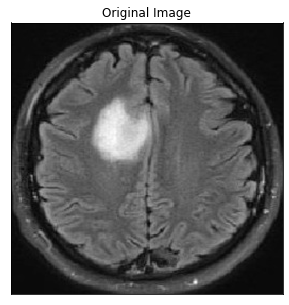

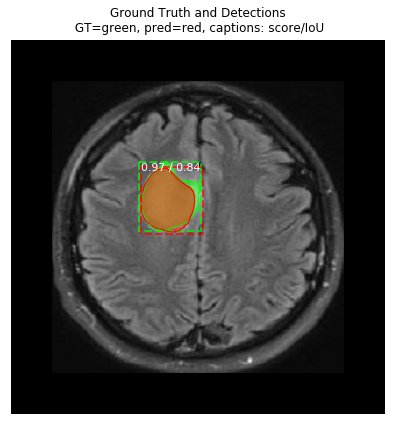

In [ ]:
ind = 0
display_image(dataset_val, ind)
predict_and_plot_differences(dataset_val, ind)

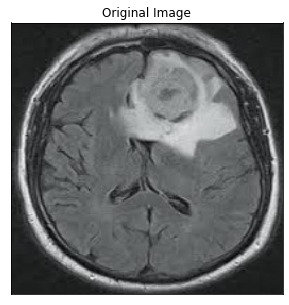

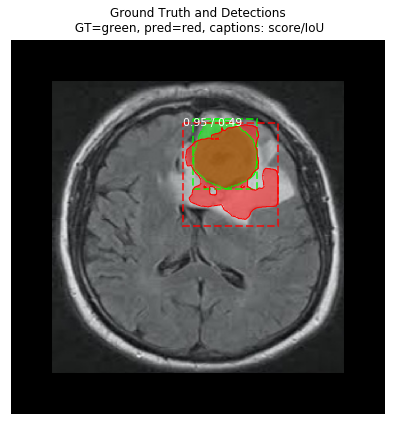

In [ ]:
ind = 10
display_image(dataset_val, ind)
predict_and_plot_differences(dataset_val, ind)

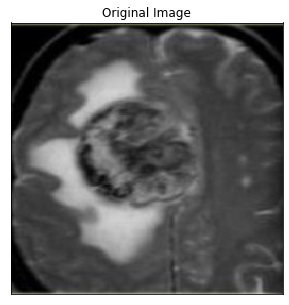

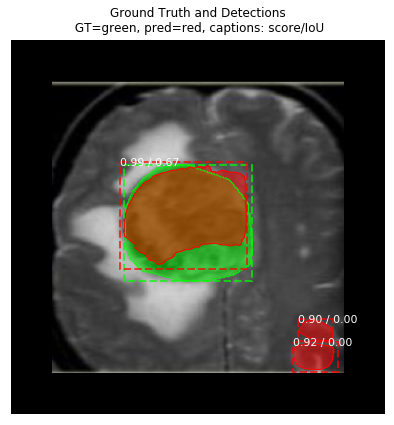

In [ ]:
ind = 4
display_image(dataset_val, ind)
predict_and_plot_differences(dataset_val, ind)

##Test Set
Let's see how model performs on images that it hasn't seen before (at least I believe that I removed all the duplicates).

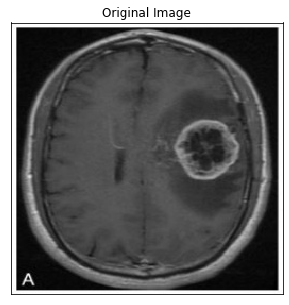

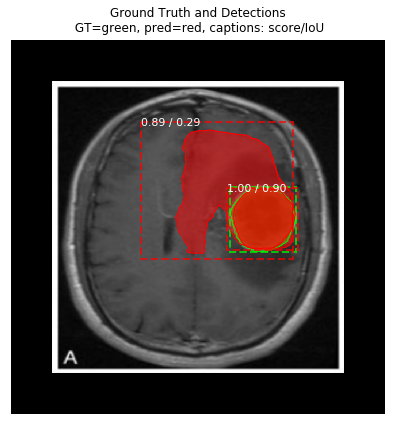

In [ ]:
ind = 0
display_image(dataset_test, ind)
predict_and_plot_differences(dataset_test, ind)

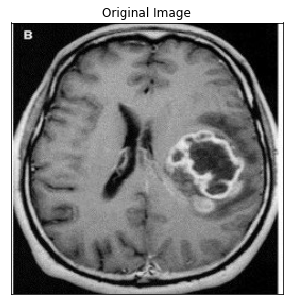

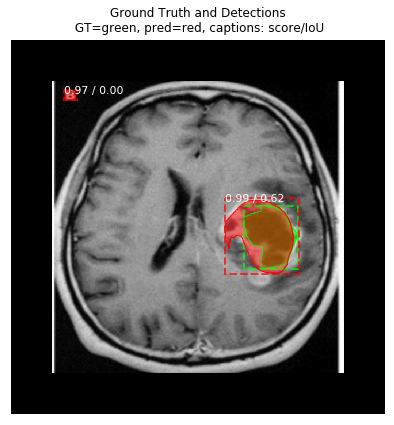

In [ ]:
ind = 1
display_image(dataset_test, ind)
predict_and_plot_differences(dataset_test, ind)

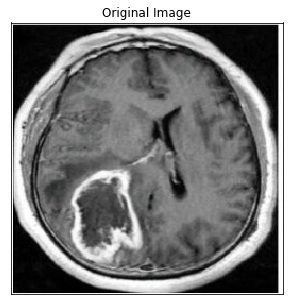

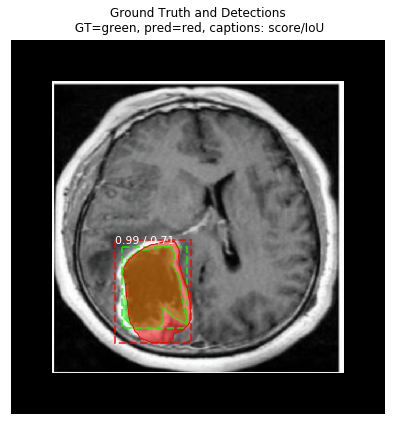

In [ ]:
ind = 2
display_image(dataset_test, ind)
predict_and_plot_differences(dataset_test, ind)

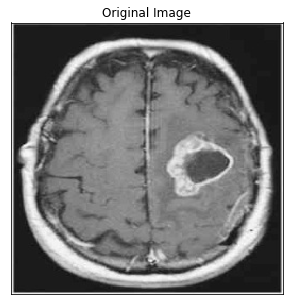

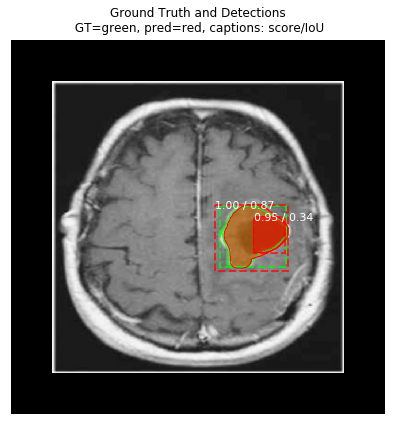

In [ ]:
ind = 3
display_image(dataset_test, ind)
predict_and_plot_differences(dataset_test, ind)

# <a id='concl'>6. Conclusions</a>

This project was a combination of CNN model classification problem (to predict wheter the subject has brain tumor or not) & Computer Vision problem (to automate the process of brain cropping from MRI scans). The final accuracy is much higher than 50% baseline (random guess). However, it could be increased by larger number of train images or through model hyperparameters tuning.

Well we've done very well just about a cycle brother just that it's a record I think I'm happy with that result and I'm also happy to share some science with you.


